# Анализ кластеров за 2016 год

In [5]:
import json
import numpy as np
from itertools import groupby
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
from scipy import spatial

import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib.ticker as ticker
import datetime
from matplotlib.dates import MO
from random import shuffle

%matplotlib notebook

In [43]:
%run ../self_similarity/hirst.py

In [7]:
class News:
    def __init__(self, id, date, title, content, url, siteType):
        self.id = id
        self.date = date
        self.title = title
        self.content = content
        self.url = url
        self.siteType = siteType
    
    @classmethod
    def from_json(cls, json_str):
        json_dict = json.loads(json_str)
        return cls(**json_dict)

In [8]:
def filter_words(text):
    words_list = text.split()
    newWords = [x for x in words_list if len(x) > 3]
    return " ".join(newWords)

# Загрузка новостей

In [9]:
news = []
with open('/data/kasandra/year/2016.all.normalized.json', encoding="utf8") as f:
    for line in f:
        news.append(News.from_json(line))
news_map = {n.id: n for n in news}

# Удаление стоп-слов

In [10]:
words = []
for n in news:
    words.extend(n.content.split())
counts = Counter(words)
one_time = [k for k, v in dict(counts).items() if v == 1]
print("total words: %s" % (len(words) - len(one_time)))

total words: 19048075


In [11]:
one_time_words = set(one_time)

# Загрузка результатов кластеризации

In [12]:
news_labels = {}
with open('/data/kasandra/year/result/2016.300.kmeans.json', encoding="utf8") as f:
    news_labels = json.loads(f.read())

In [13]:
cluster_news = {}
for n_id, label in news_labels.items():
    if label in cluster_news:
        n_list = cluster_news[label]
        n_list.append(news_map[n_id])
    else:
        n_list = []
        n_list.append(news_map[n_id])
        cluster_news[label] = n_list

# Векторизация

In [14]:
news_constent = [filter_words(x.content) for x in news]

In [15]:
tfidf_vectorizer = TfidfVectorizer(use_idf=True, tokenizer=lambda text: text.split(" "), stop_words=one_time_words,
                                   max_df=0.5, min_df=2, norm='l2')

tfidf_matrix = tfidf_vectorizer.fit_transform(news_constent)
print("vocabulary size: %s" % len(tfidf_vectorizer.vocabulary_))

vocabulary size: 95475


# Количество новостей в кластерах

In [17]:
titles = [n.title for n in cluster_news[74]]
titles[:10]

['Белорусские спортсмены пронесут российский флаг во время открытия Паралимпиады',
 'Белорусские паралимпийцы пронесли флаг России на открытии Игр в Рио',
 'МПК устанавливает личность белоруса, вынесшего флаг России на "Маракане"',
 'IPC расследует вынос флага России белорусами на открытии Игр',
 'МПК заинтересовался личностью пронесшего флаг России белорусского паралимпийца',
 'IPC проведет расследование в отношении белорусов за вынос российского флага',
 'IPC опознал белоруса, несшего российский флаг на открытии Паралимпиады',
 'Личность пронесшего флаг России на открытии Паралимпиады белоруса установлена',
 'Паралимпийцев из Белоруссии накажут за вынос российского флага',
 'Паралимпийский комитет идентифицировал белорусского атлета, пронёсшего флаг РФ']

# Сегментирование кластеров по дням

In [18]:
# 2016
start_year = 1451595600 * 1000
end_year = 1483217999 * 1000 + 1
day_millis = 24 * 60 * 60 * 1000

## Сегментация по конкретным дням

In [19]:
def segment_news_daily(seg_news):
    segmented_news = {}
    for start_day in range(start_year, end_year, day_millis):
        end_day = start_day + day_millis
        cur_news = [n for n in seg_news if n.date >= start_day and n.date < end_day]
        segmented_news[start_day] = cur_news
    return segmented_news

# Вычисление отклонений для кластера

In [20]:
# year_centrid = np.array(tfidf_matrix.mean(axis=0))[0]
year_centrid = np.empty(tfidf_matrix.shape[1])
year_centrid.fill(1)

In [33]:
def day_cos(day_news):
    cos_news = {}
    for day, d_news in day_news.items():
        if len(d_news) > 0:
            content_day = [filter_words(x.content) for x in d_news]
            tfidf_day = tfidf_vectorizer.transform(content_day)
            day_centroid = np.array(tfidf_day.mean(axis=0))[0]
            cos_news[day] = 1 - spatial.distance.cosine(year_centrid, day_centroid)
        else:
            cos_news[day] = 0
    return cos_news

# Отрисовка графика

In [22]:
def plot_cos_centroid(cos_days, start_day, end_day, label):
    # plt.rcParams['figure.figsize'] = (20.0, 8.0)
    # plt.rcParams['font.size'] = 12
    fig, ax = plt.subplots()

    myFmt = mdates.DateFormatter('%d.%m.%Y')
    ax.xaxis.set_major_formatter(myFmt)
    ax.xaxis.set_major_locator(mdates.WeekdayLocator(byweekday=MO))

    datemin = datetime.datetime.fromtimestamp(start_day/1000) - datetime.timedelta(days=7)
    datemax = datetime.datetime.fromtimestamp(end_day/1000) + datetime.timedelta(days=7)
    ax.set_xlim(datemin, datemax)
    
    x = []
    y = []
    
    sorted_dates = sorted(list(cos_days.keys()))
    
    for ddd in sorted_dates:
        x.append(datetime.datetime.fromtimestamp(ddd/1000))
        y.append(cos_days[ddd])

    ax.plot(x, y, label = label)
    ax.legend(loc='upper right')
    fig.autofmt_xdate(rotation=60)
    fig.show()

# Вывод N первых новостей из кластера

In [23]:
def print_news(cl_news, n, cl_label):
    rand_news = []
    rand_news.extend(cl_news)
    shuffle(rand_news)
    
    print("cluster: %s, %s из %s новостей:" %(cl_label, n, len(cl_news)))
    for nn in rand_news[:n]:
        print("\t %s" % nn.title)

# Отображение сегментов

In [30]:
def compute_for_cluster(segment_method, cl_news, cluster_number):
    segmented_news = segment_method(cl_news)
    cos_news = day_cos(segmented_news)
    
    return cos_news

In [36]:
def plot_sgmented_cluster(cos_news, cluster_number, cl_news):
    print("График для кластера: %s" % (cluster_number))
    plot_cos_centroid(cos_news, start_year, end_year, cluster_number)
    print_news(cl_news, 10, cluster_number)
    print("----------------------")

# Фильтрация кластеров
убираем нулевой кластер и кластеры с маленьким количеством новостей

In [45]:
max_cluster_size = 2000
mix_cluster_size = 0

In [46]:
medium_clusters = {k: v for k, v in cluster_news.items() if len(v) >= mix_cluster_size and len(v) <= max_cluster_size }
print("count clusters: %s" % len(medium_clusters))

count clusters: 299


# Графики

## Сегментация по дням

In [47]:
cos_results = []

for c_label, c_news in medium_clusters.items():
    day_cos_res = compute_for_cluster(segment_news_daily, c_news, c_label)
    cos_results.append((c_label, c_news, day_cos_res))

# Анализ самоподобия

In [50]:
hirst_results = []
for c_label, c_news, dd_cos in cos_results:
    hist = SelfSimilarityHirst()
    itemms = list(dd_cos.items())
    try:
        h_res = hist.compute(itemms)
    except Exception:
        print("bad cluster: %s, count news: %s" % (c_label, len(c_news)))
        continue
    
    hirst_results.append((c_label, c_news, dd_cos, h_res))

bad cluster: 101, count news: 379


In [54]:
hirst_results_sorted = sorted(hirst_results, key=lambda x: x[3].hirst_coefficient, reverse=True)

In [73]:
first_20 = hirst_results_sorted[:20]
last_20 = hirst_results_sorted[-20:]

## Первые 20 кластеров

---График для кластера: 75


/anaconda/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


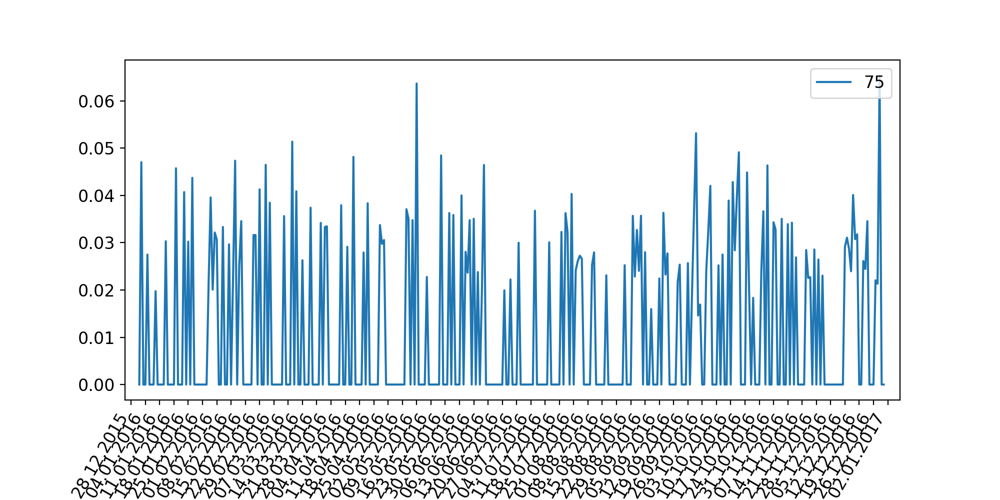

cluster: 75, 10 из 189 новостей:
	 Климатическая миграция
	 Слетать в отпуск в бархатный сезон стало дешевле
	 Туры по цене перелёта: на море за 10 тыс. рублей и ещё дешевле
	 Россиянам рассказали, когда ждать роста цен на бензин
	 Росалкогольрегулирование обнародовало проект приказа о повышении цены на водку
	 Глава ЛУКОЙЛа оценил рост цен на бензин в 2017 году
	 В России введут минимальную цену на вино
	 В России может подорожать топливо
	 Сколько стоит проезд в метро в разных странах
	 На лыжах в Пирины
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.00014118268859614043, ln(variance): -8.865455842431711, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.00018400968209547727, ln(variance): -8.600522181655561, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.00021154925651235222, ln(variance): -8.461052695281555, ln(m): -4.51085950651685)
mi: 1/73, variance: 0.00021494793127690601, ln(variance): -8.445114739274363, ln(m): -4.290459441148391)
mi: 1/61, variance: 

<IPython.core.display.Javascript object>


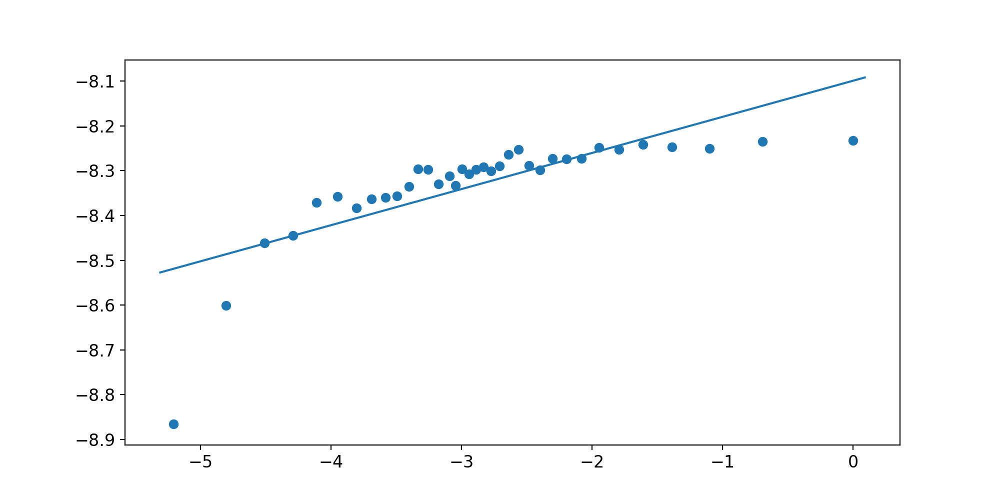

----------------------
---График для кластера: 248


<IPython.core.display.Javascript object>


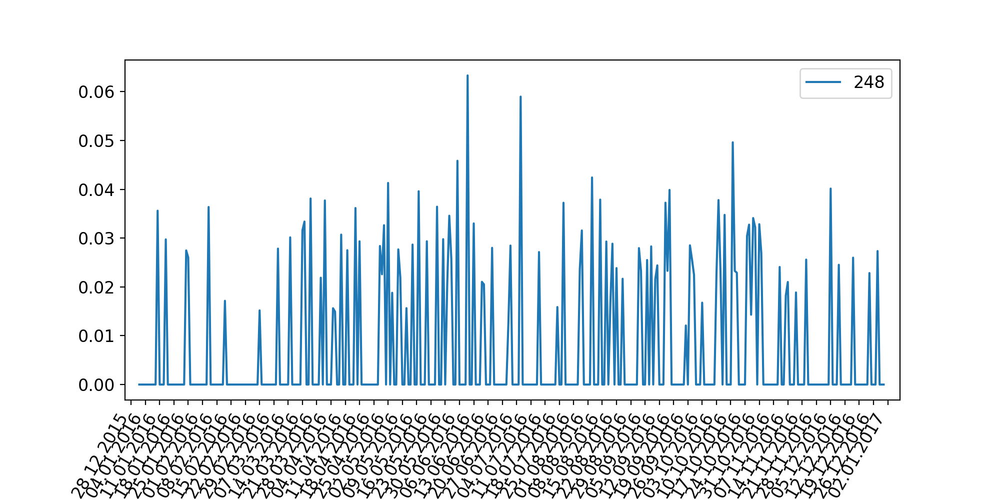

cluster: 248, 10 из 124 новостей:
	 В Татарстане поступило в продажу мороженое "Обамка"
	 Новогодний выпуск альманаха "Мульт в кино" уже в кинотеатрах России
	 Создатель "Маши и Медведя" признан инноватором
	 «Мы бедные»
	 Режиссёр «Маши и медведя» не считает свой мультик опасным для детской психики
	 «В 90-е убивали, сегодня увольняют»
	 Выбери любимый: десять лучших наших мультфильмов
	 В сети появился путеводитель по кинопародиям «Симпсонов»
	 Винни-Пух и все-все-все: главные мультипликационные роли Евгения Леонова
	 Тест: Так ли хорошо вы знаете советские мультики?
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 8.947768991864523e-05, ln(variance): -9.321521238409563, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.00011576055388343096, ln(variance): -9.063986690895833, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.00014320226594869784, ln(variance): -8.85125247989883, ln(m): -4.51085950651685)
mi: 1/73, variance: 0.00014174029339625787, ln(variance): -8.86

<IPython.core.display.Javascript object>


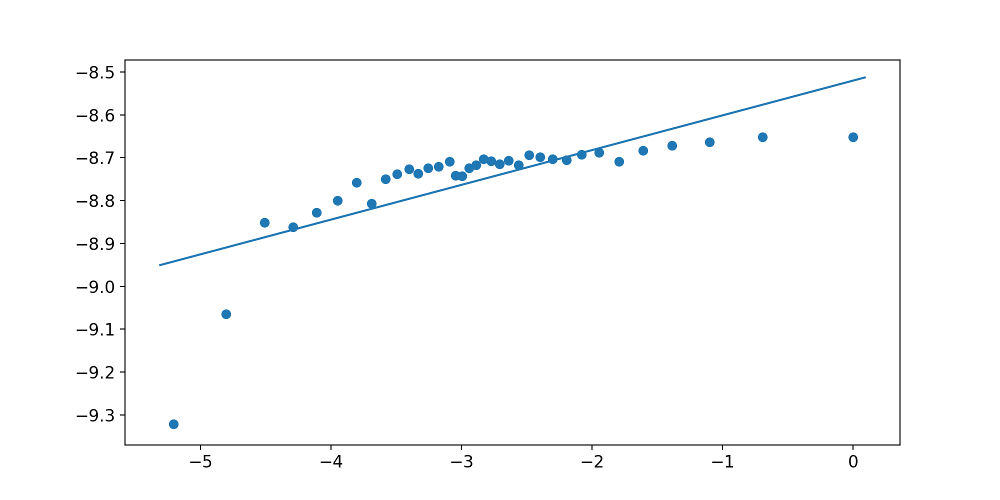

----------------------
---График для кластера: 42


<IPython.core.display.Javascript object>


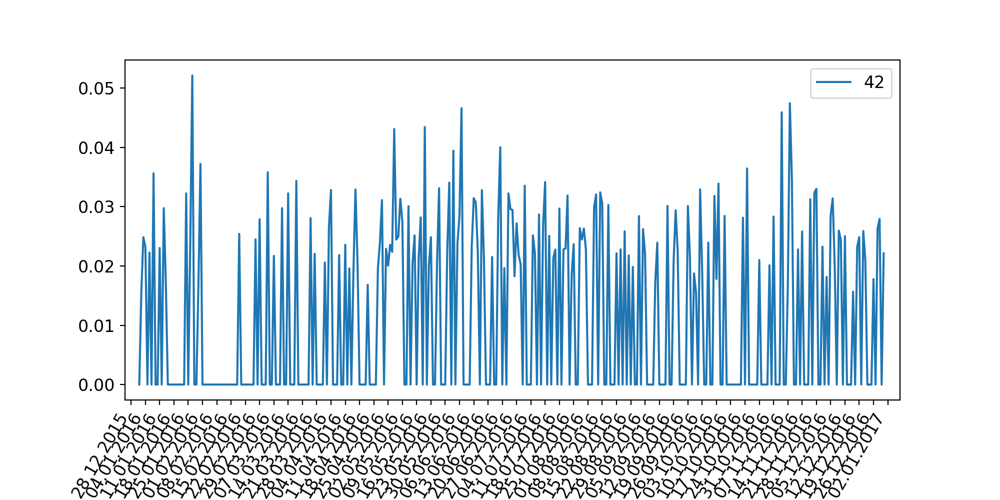

cluster: 42, 10 из 259 новостей:
	 В Москве объявлен "оранжевый" уровень опасности из-за непогоды
	 В Кувейте зафиксирована самая высокая температура на Земле
	 Погода на выходные: оранжевая Москва, тонущий Сочи и осень в Мурманске
	 Новогодняя ночь в Москве обещает быть тёплой: температура не опустится ниже 0°C
	 В Москве ожидается рекордная жара
	 Часть Ближнего Востока и Северной Африки к 2050 году станут непригодными для жизни
	 Из-за жары в Москве объявлен оранжевый уровень опасности
	 "Бабье лето" уйдет из Москвы во вторник
	 Москвичам посоветовали в День знаний одеваться потеплее
	 Экстремальный ливень в Москве побил сразу три "мокрых" рекорда
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.00010352981497695501, ln(variance): -9.175650919332107, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.0001235710978680572, ln(variance): -8.998693876303543, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.00014291208335888173, ln(variance): -8.853280918458562, ln(m)

<IPython.core.display.Javascript object>


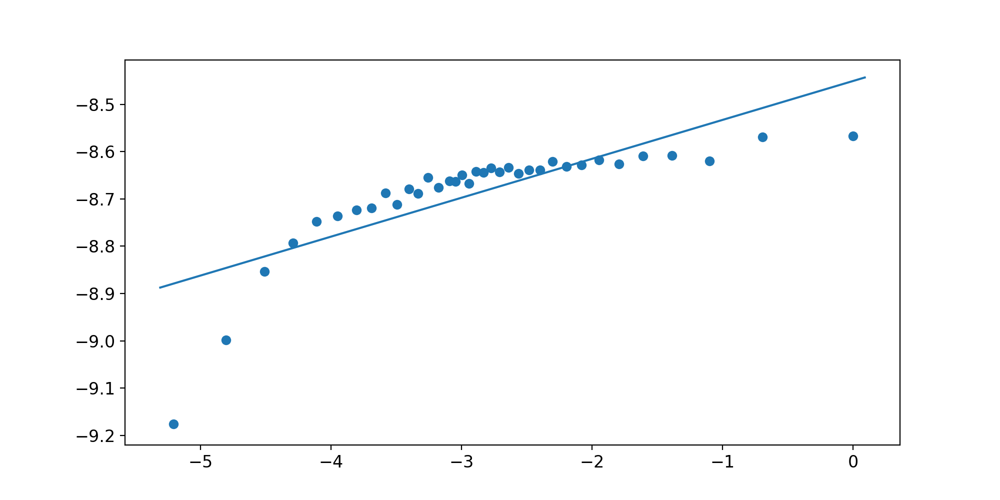

----------------------
---График для кластера: 47


<IPython.core.display.Javascript object>


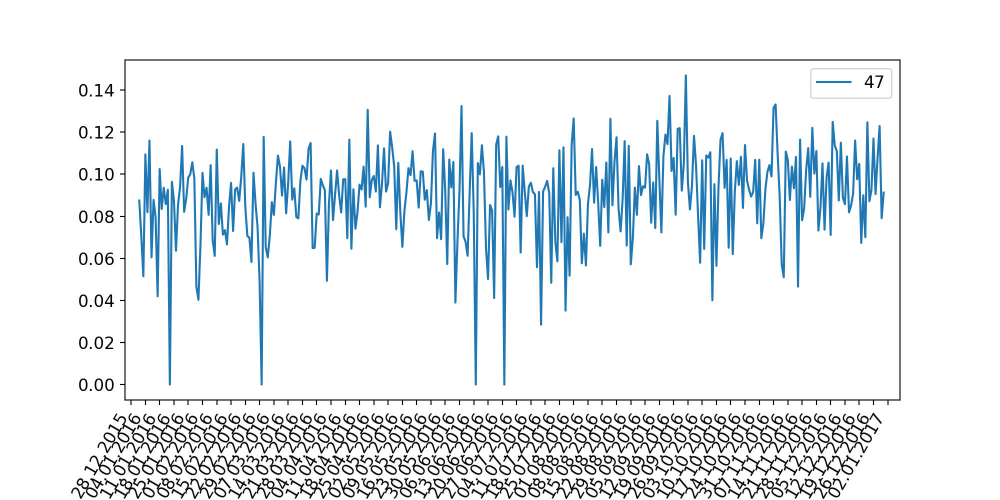

cluster: 47, 10 из 1974 новостей:
	 Подземные бункеры Матуа
	 Жизнь с миллионером: То нос разобьет, то машину подарит
	 Россия отмечает 8 марта — в регионах страны звучат поздравления и проходят праздничные мероприятия
	 «Одиночество за границей привело меня к неврозу»
	 Усыновленный в Петербурге ребенок через двадцать лет зарезал приемных родителей в Италии
	 Как не сорвать спину на грядках
	 Мне уже «за», но я еще не против
	 Горячий сентябрь: обрезай и копай
	 «Я не хочу навязывать свое мнение слушателям»
	 Бери что хочешь!
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.00024016050112892336, ln(variance): -8.334203103435216, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.0003173287572581631, ln(variance): -8.055572232349942, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.0003503164845999436, ln(variance): -7.956673570346944, ln(m): -4.51085950651685)
mi: 1/73, variance: 0.0003617446473183018, ln(variance): -7.924571989194352, ln(m): -4.290459441148391)
mi

<IPython.core.display.Javascript object>


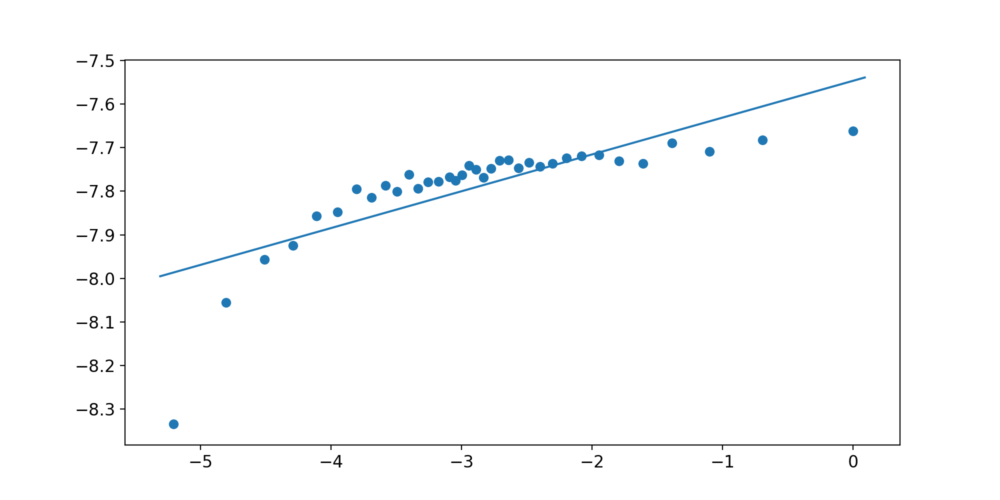

----------------------
---График для кластера: 255


<IPython.core.display.Javascript object>


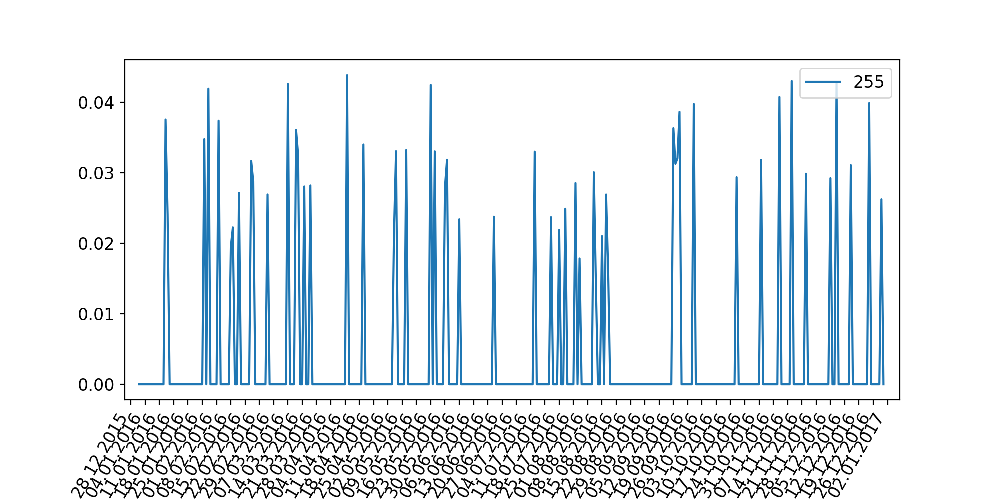

cluster: 255, 10 из 87 новостей:
	 Московские таксисты подняли цены из-за ливня, но машин всё равно не хватает
	 Пятилетний забег: как изменился «Яндекс» с момента IPO
	 Песков пожаловался на сбивающийся у Кремля навигатор
	 "Касперский" против Microsoft: из-за чего поссорились IT-гиганты
	 Ъ: в Госдуме предложили приравнять "Яндекс" и Google к СМИ
	 Москвич подал в суд на "Яндекс" за то, что облысел из-за негативных новостей
	 Московские власти пригрозили запретить Uber
	 ФАС нашла нарушения закона о рекламе у «Яндекса» и «Вестника ЗОЖ»
	 «Яндекс» начал переговоры о партнерстве с Facebook
	 «Бан» на Uber: могут ли столичные власти запретить сервис такси
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 6.327457313481786e-05, ln(variance): -9.668026997745999, ln(m): -5.209486152841421)
mi: 1/122, variance: 8.463471329786278e-05, ln(variance): -9.37716605284165, ln(m): -4.804021044733257)
mi: 1/91, variance: 9.554709416152202e-05, ln(variance): -9.25589129944612, ln(m)

<IPython.core.display.Javascript object>


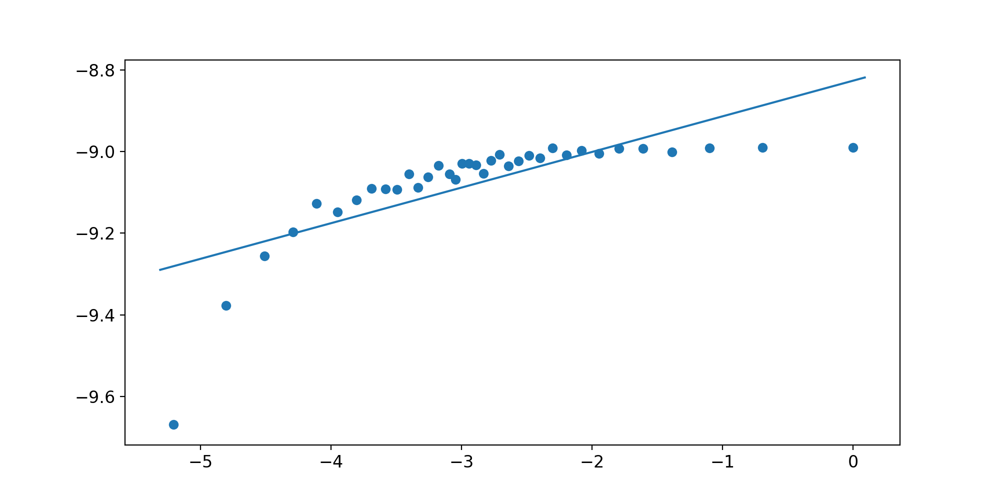

----------------------
---График для кластера: 7


<IPython.core.display.Javascript object>


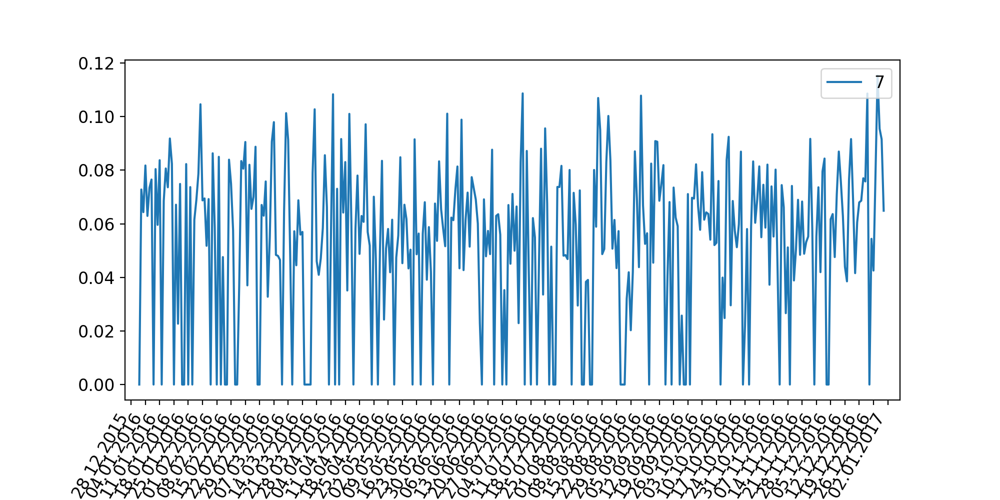

cluster: 7, 10 из 681 новостей:
	 Первая мировая: 1914 – 1918 гг. от фронта до тыла
	 Технологию майдана ЦРУ впервые обкатало в Венгрии 60 лет назад
	 В Пентагоне не вспомнили про 71 годовщину победы над Германией
	 Со щита киевской "Родины-матери" уберут герб СССР
	 Руки в крови
	 Кто читает "Капитал" в XXI веке
	 За руку с Гитлером здоровались вожди Запада. А виноват Сталин?
	 Фурсенко рассказал о специфических проблемах России
	 Увидеть Орландо
	 География учит войне. Самые взрывоопасные школьные дисциплины
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.000489973776658409, ln(variance): -7.6211586853153435, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.00061760750505106, ln(variance): -7.389657407366629, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.000679626554298657, ln(variance): -7.293967095506275, ln(m): -4.51085950651685)
mi: 1/73, variance: 0.0007272430116747285, ln(variance): -7.226249869882669, ln(m): -4.290459441148391)
mi: 1/61, variance: 0.0

<IPython.core.display.Javascript object>


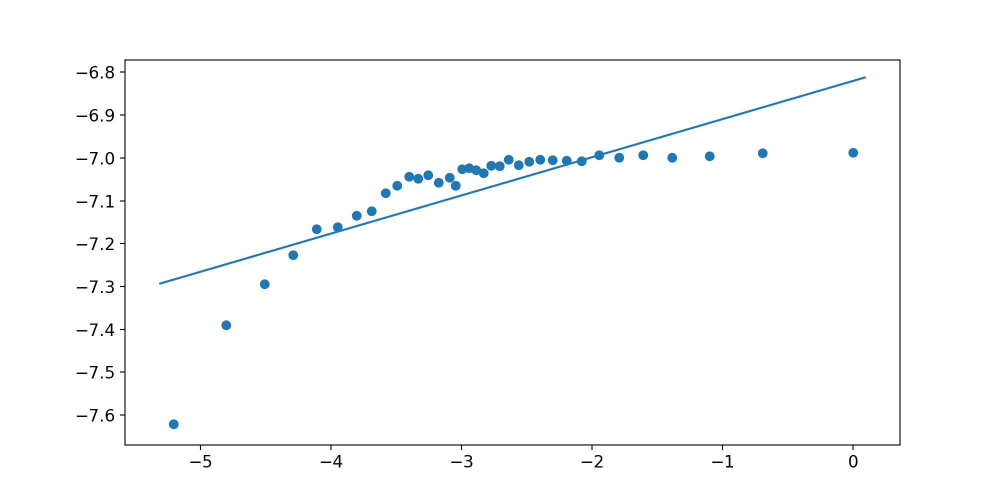

----------------------
---График для кластера: 283


<IPython.core.display.Javascript object>


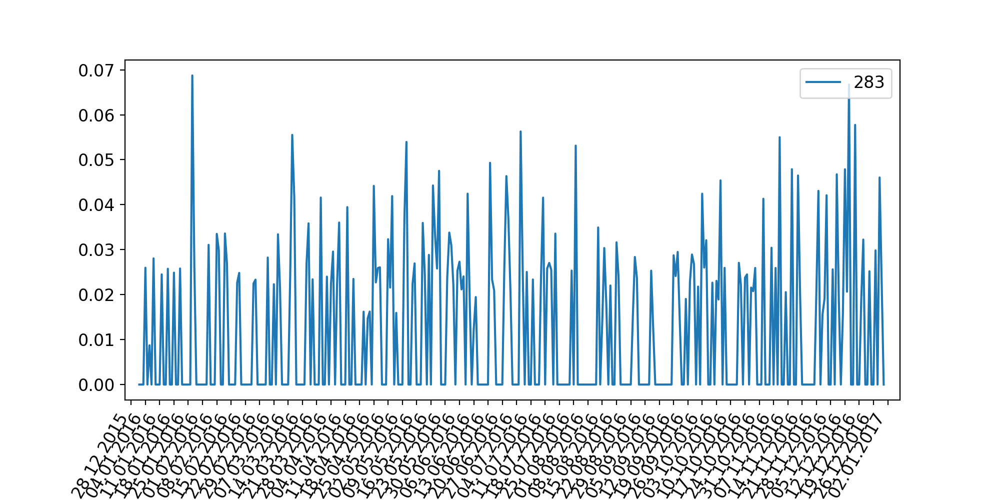

cluster: 283, 10 из 232 новостей:
	 Вышел трейлер нового сериала Marvel c актером из «Игры престолов»
	 Названа страна-лидер по скачиванию пиратской «Игры престолов»
	 Раскрыта главная интрига нового сезона «Игры престолов»: жив или мертв Джон Сноу
	 Раскрыта одна из главных интриг нового сезона "Игры Престолов"
	 Сбривший бороду Джон Сноу отпугнул поклонников
	 В сети посмеялись над русскоязычными вывесками из корейского сериала про Россию
	 Двое против всех: Малдер и Скалли снова объединились в поисках инопланетных и вполне земных врагов
	 Опрос: какая роль в "Игре престолов" подойдёт Дэниелу Рэдклиффу?
	 Кто вы в "Игре престолов"
	 В сериале "Американская семейка" сыграет ребёнок-трансгендер
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.00011382188432122652, ln(variance): -9.080875749652861, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.00017841586788049638, ln(variance): -8.631393396255305, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.000195407176452

<IPython.core.display.Javascript object>


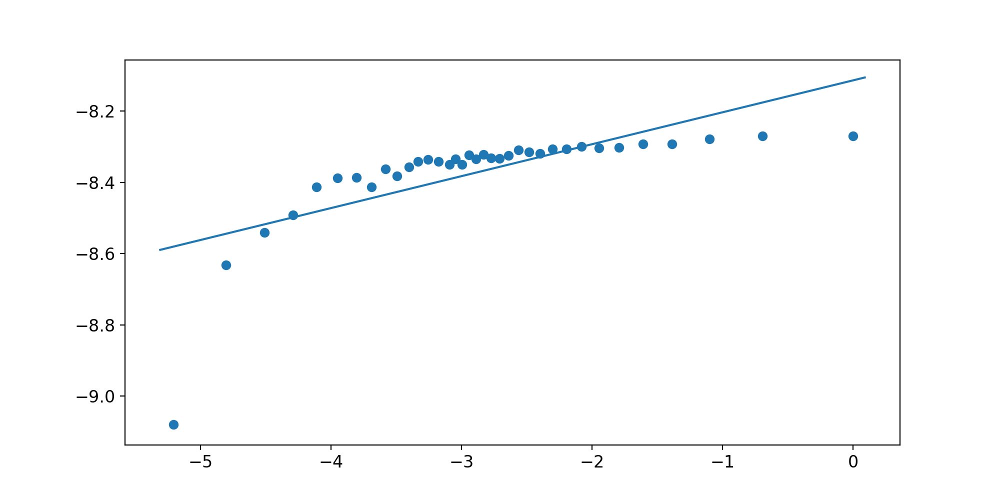

----------------------
---График для кластера: 189


<IPython.core.display.Javascript object>


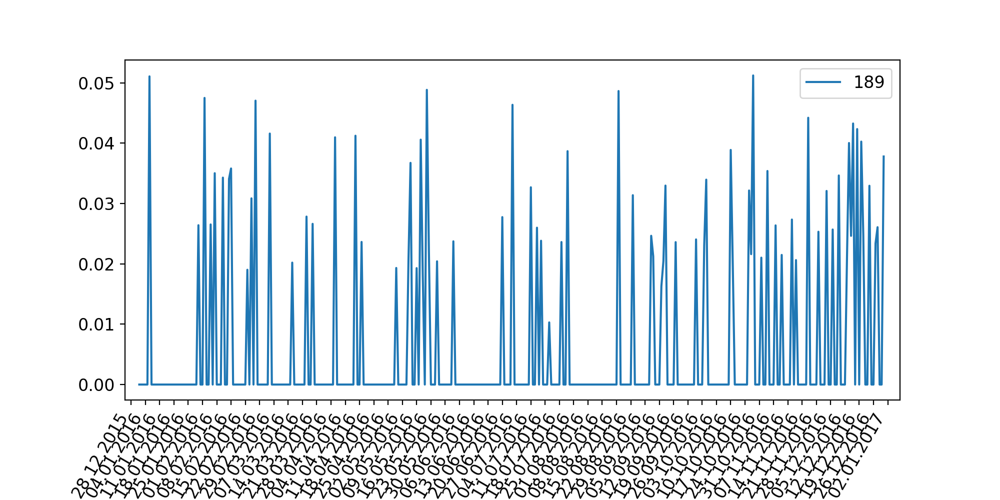

cluster: 189, 10 из 123 новостей:
	 На ваш страх и риск: экспонаты музеев России не застрахованы
	 В немецком музее посетительница заполнила кроссворд на картине за 80 тысяч евро
	 Уволившаяся в Фейсбуке. Директор музея архитектуры не писала заявление об уходе
	 Эрмитаж внесли в тройку лучших музеев мира
	 Мой воображаемый друг
	 Музейные тропы Подмосковья
	 УФСБ вернуло музею в Хабаровске картину, украденную 70 лет назад
	 Свиблова раскрыла подробности визита Канье Уэста в московский музей
	 7 самых необычных музеев мира
	 Ляшко пообещал вернуть Киеву Крым вслед за золотом скифов
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 8.32336752255089e-05, ln(variance): -9.393858541719824, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.0001164633321417365, ln(variance): -9.057934080065793, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.00012085887674382769, ln(variance): -9.02088700093614, ln(m): -4.51085950651685)
mi: 1/73, variance: 0.00013351285229361127, ln(varian

<IPython.core.display.Javascript object>


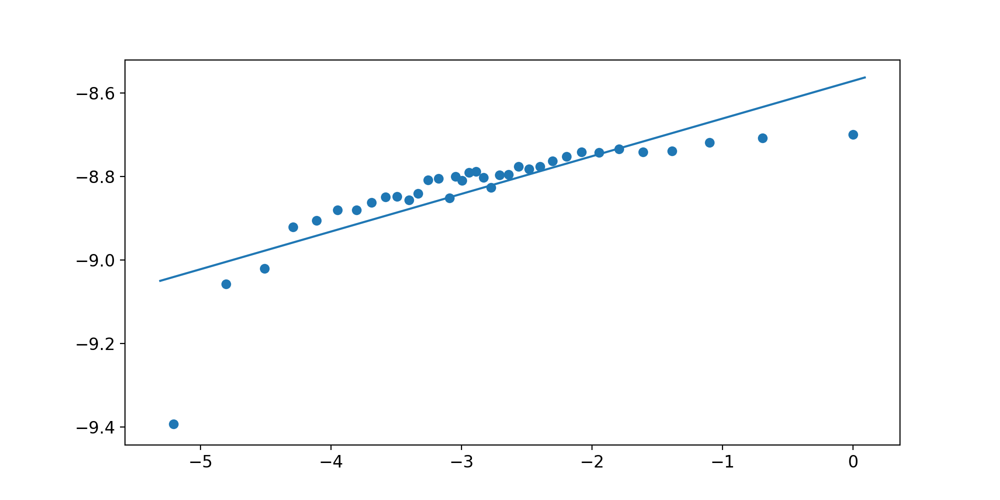

----------------------
---График для кластера: 285


<IPython.core.display.Javascript object>


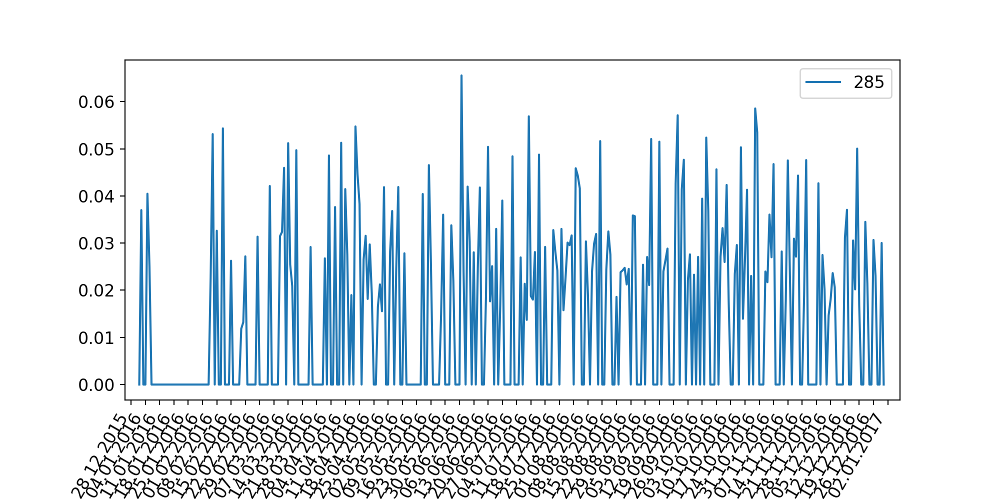

cluster: 285, 10 из 287 новостей:
	 Террористы могут завладеть российским и американским ядерным оружием
	 Литва распродала полученные от Пентагона винтовки вопреки запрету Вашингтона
	 Германский автомат для Пятой республики
	 Ствол раздора
	 СМИ: Пакистан из-за фейковой статьи пригрозил Израилю ядерным оружием
	 The Nation: США превратили Украину в "супермаркет нелегального оружия"
	 Подробности гибели бойца Росгвардии: пуля прошла рикошетом
	 В США готовят к производству модернизированную атомную бомбу B61-12
	 Россия не одобряет идею выработки конвенции о запрещении ядерного оружия
	 Опубликовано видео испытаний нового американского оружия для сдерживания России
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.00014475825339552574, ln(variance): -8.840445424860134, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.00020825615110032152, ln(variance): -8.476741740257152, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.00023480576876101878, ln(variance): -8.35675

<IPython.core.display.Javascript object>


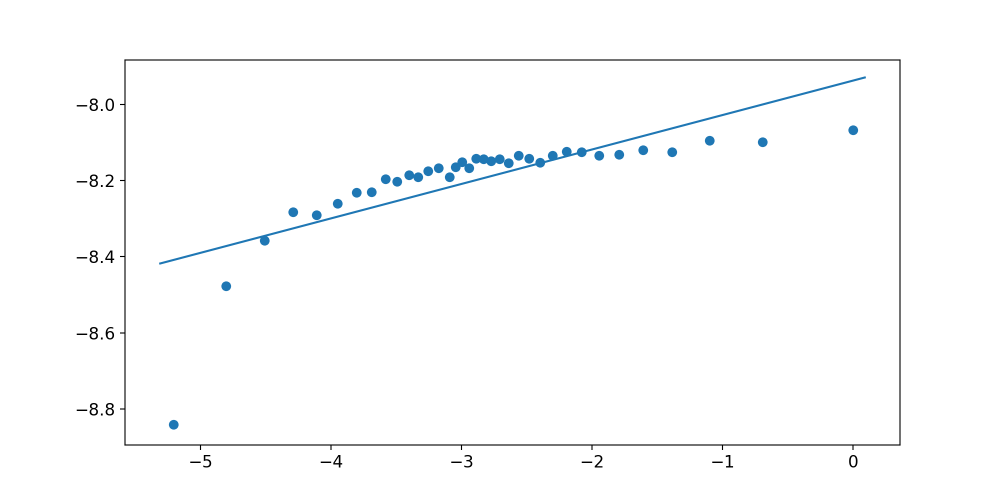

----------------------
---График для кластера: 221


<IPython.core.display.Javascript object>


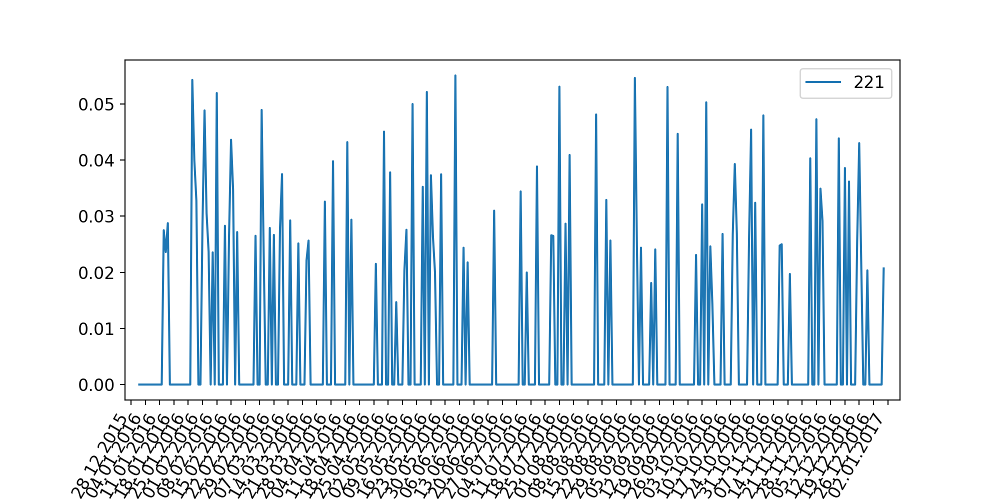

cluster: 221, 10 из 160 новостей:
	 ФСБ сообщила о масштабной кибератаке на российские организации
	 В США выявили случай передачи вируса Зика половым путем
	 Вызывающий бородавки вирус достался человеку от неандертальцев
	 Тест: Вы в зоне риска заражения ВИЧ?
	 Россия представит в Женеве отечественную вакцину от Эболы
	 Передача вируса Зика половым путем зафиксирована в США
	 В России зафиксирован первый случай заболевания вирусом Зика
	 Компьютеры компании Apple впервые поразил вирус
	 За добровольную смерть от лихорадки Эбола россиянам заплатят два миллиона рублей
	 Лето в клещах: в этом году переносчики опасных инфекций проснулись раньше срока
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.00011679556423000577, ln(variance): -9.055085465774138, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.00015417400337172605, ln(variance): -8.777428701374022, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.00017886434921310658, ln(variance): -8.628882865043616, ln(m): 

<IPython.core.display.Javascript object>


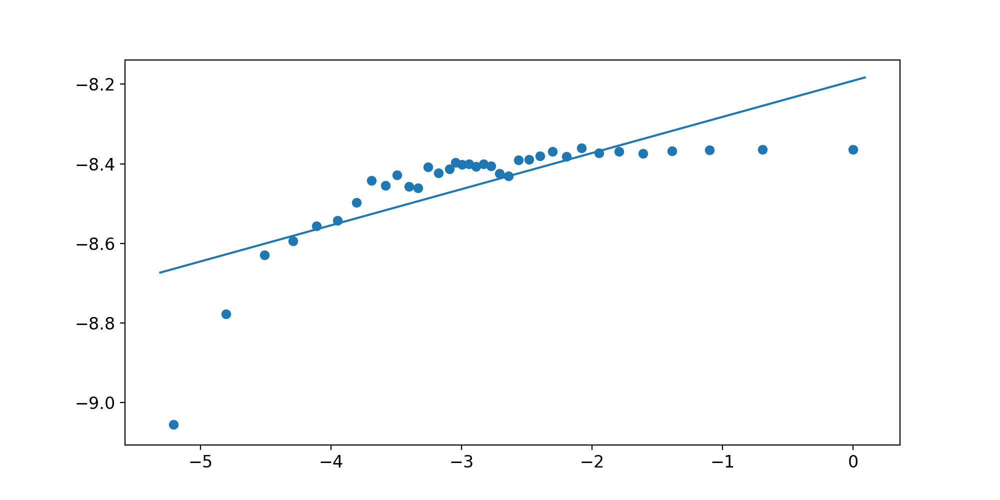

----------------------
---График для кластера: 162


<IPython.core.display.Javascript object>


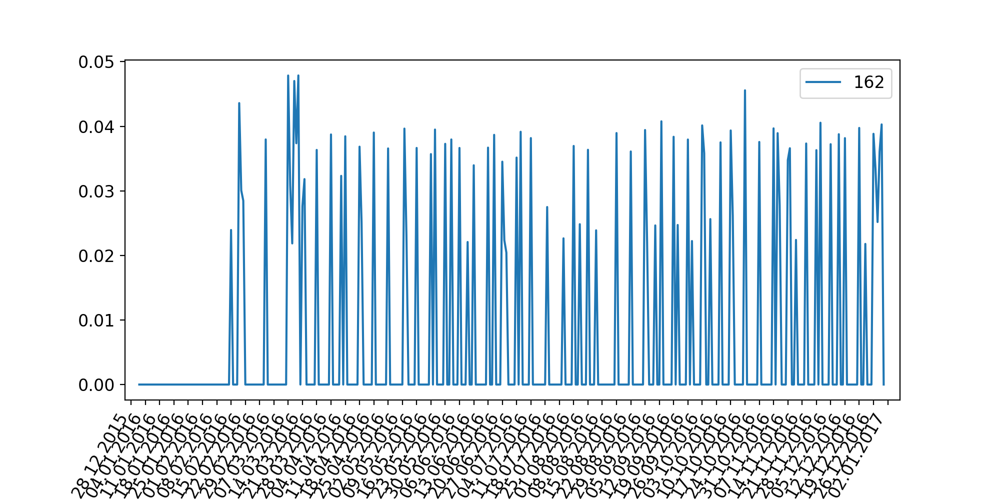

cluster: 162, 10 из 99 новостей:
	 Она живет вопреки прогнозу
	 Читатели Вестей.Ru и Русфонда спасли Вику Худякову
	 Читатели Вестей.Ru и Русфонда спасли Настю Яковлеву
	 Читатели Вестей.Ru и Русфонда спасли Сашу Пигуль
	 Слабое сердце
	 Читатели Вестей.Ru и Русфонда спасли Сашу Безрядину
	 Нужна помощь: Сашу Титаева спасет лекарство против опухоли
	 Нужна помощь: Еву Щербак спасет курсовое лечение
	 Помощь детям: истории спасения
	 Нужна помощь: Настю Автину спасет операция на сердце
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 9.852890420298084e-05, ln(variance): -9.225160609147323, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.000144593693184449, ln(variance): -8.841582864789352, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.0001574483237258074, ln(variance): -8.756413256864468, ln(m): -4.51085950651685)
mi: 1/73, variance: 0.00016927990298406224, ln(variance): -8.683956982403776, ln(m): -4.290459441148391)
mi: 1/61, variance: 0.00017455015766671713, ln

<IPython.core.display.Javascript object>


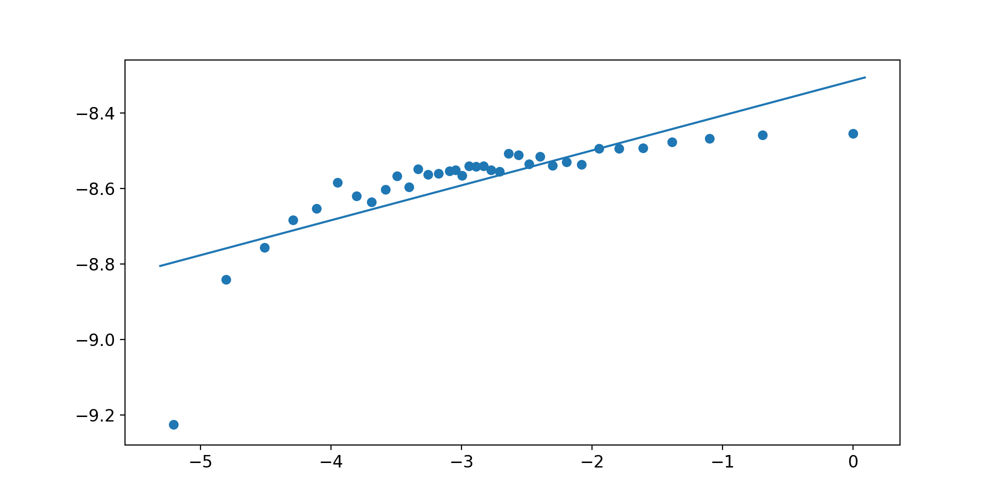

----------------------
---График для кластера: 107


<IPython.core.display.Javascript object>


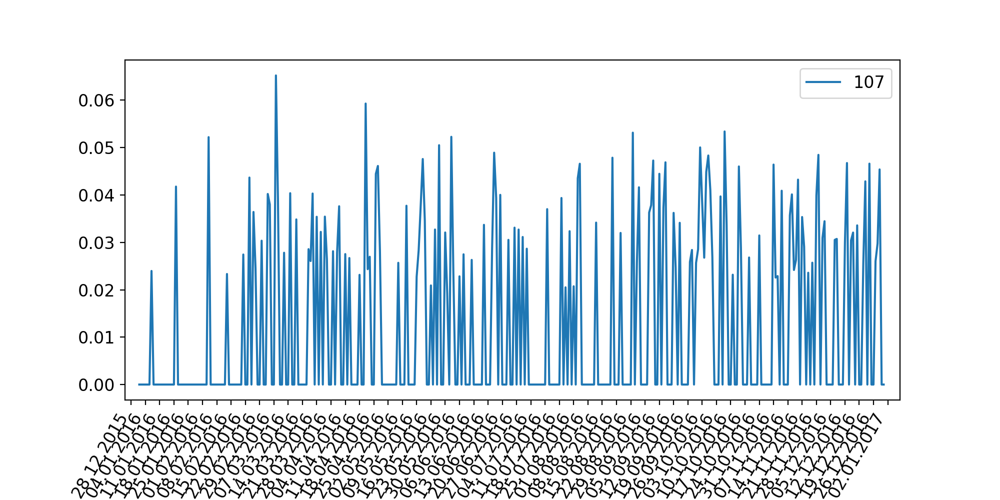

cluster: 107, 10 из 187 новостей:
	 Ученые раскрыли происхождение клеток-убийц
	 Нобелевский лауреат за 950 тысяч баксов объяснил, как голодание укрепляет здоровье и продляет молодость
	 Пять главных медицинских открытий 2016 года
	 Доковырялись
	 Российские учёные создали малотоксичное лекарство от рака
	 Раскрыта тайна самого выносливого существа на Земле
	 Названы замедляющие генетическое старение физические упражнения
	 Ученые нашли супервещества, которые победят диабет, синдром Альцгеймера и склероз
	 В США разрешили генетические эксперименты на людях
	 Ученые нашли гены "зомби", включающиеся через пять дней после смерти
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.00015702492497024606, ln(variance): -8.75910600744438, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.0002018242510745322, ln(variance): -8.508113283456673, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.000229200708450463, ln(variance): -8.38091248215786, ln(m): -4.51085950651685)
mi: 1/73

<IPython.core.display.Javascript object>


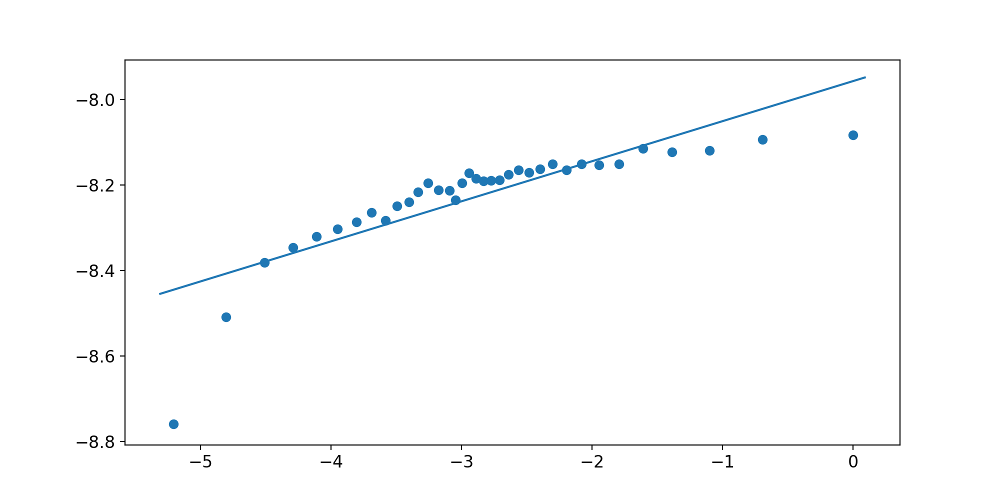

----------------------
---График для кластера: 130


<IPython.core.display.Javascript object>


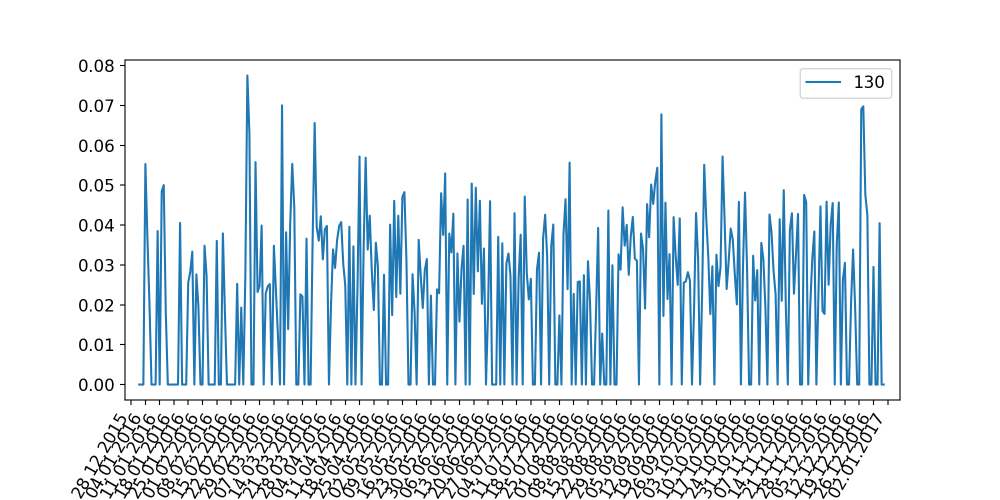

cluster: 130, 10 из 544 новостей:
	 Трудовые будни Ракетных войск стратегического назначения
	 Трансгендерам разрешат служить в армии США
	 Минобороны выпустило праздничный видеоролик ко Дню сухопутных войск РФ
	 Коррупция расформировала Спецстрой
	 Эксклюзивный репортаж: "Вести в субботу" проникли в Национальный центр обороны
	 Азербайджан, Турция и Грузия проведут совместные учения
	 Экс-главкому Сухопутных войск со снятой судимостью подыскали новую работу
	 В России разработан комплекс радиоэлектронной борьбы нового поколения
	 Шойгу: необходимо создать новые подразделения военной полиции
	 СМИ узнали о решении Путина ликвидировать Спецстрой
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.00017100919354383405, ln(variance): -8.67379323949258, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.0002248625875306457, ln(variance): -8.40002106441257, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.00025899830898887895, ln(variance): -8.258689025286518, ln(m): -4.510

<IPython.core.display.Javascript object>


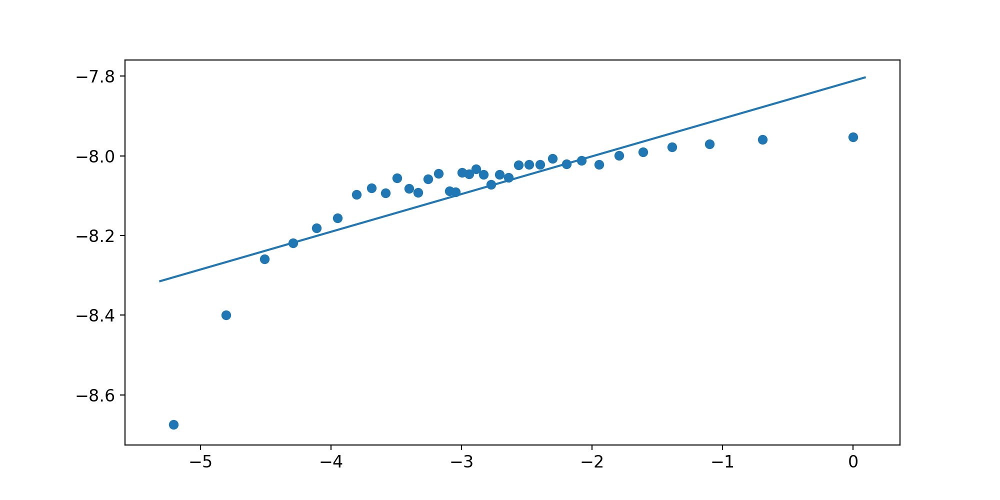

----------------------
---График для кластера: 85


<IPython.core.display.Javascript object>


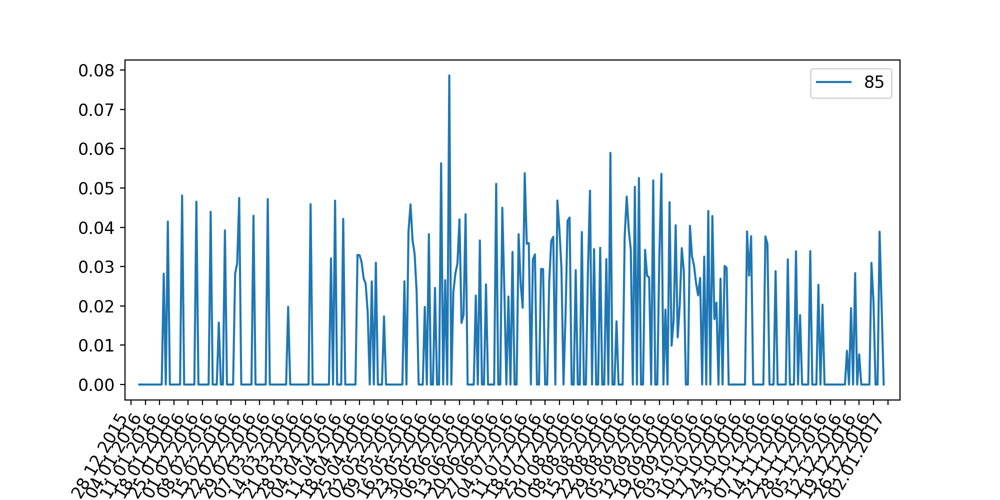

cluster: 85, 10 из 227 новостей:
	 На "Нашествии" Князь оседлал "Тигра"
	 Всемирный фестиваль молодежи в Сочи остался без финансирования
	 В Испании завершилась помидорная битва "Томатина"
	 Панки выступят на турнире по метанию коровьих лепешек в Прикамье
	 Нашумевшая «зеленая голова» покинула площадь Пушкина
	 Очевидцы рассказали о том, как ударила молния на рок-фестивале в Германии
	 "Круг света" завершается грандиозным шоу
	 В Москве отменили очередной музыкальный фестиваль
	 В Москве отменили музыкальный фестиваль RAW FEST
	 XV Международный Канский видеофестиваль пройдет в Москве
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.00014383785174123514, ln(variance): -8.846823922410646, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.00018567883919743875, ln(variance): -8.59149204764711, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.00021166562082228807, ln(variance): -8.460502788748963, ln(m): -4.51085950651685)
mi: 1/73, variance: 0.0002249091550490087, ln(

<IPython.core.display.Javascript object>


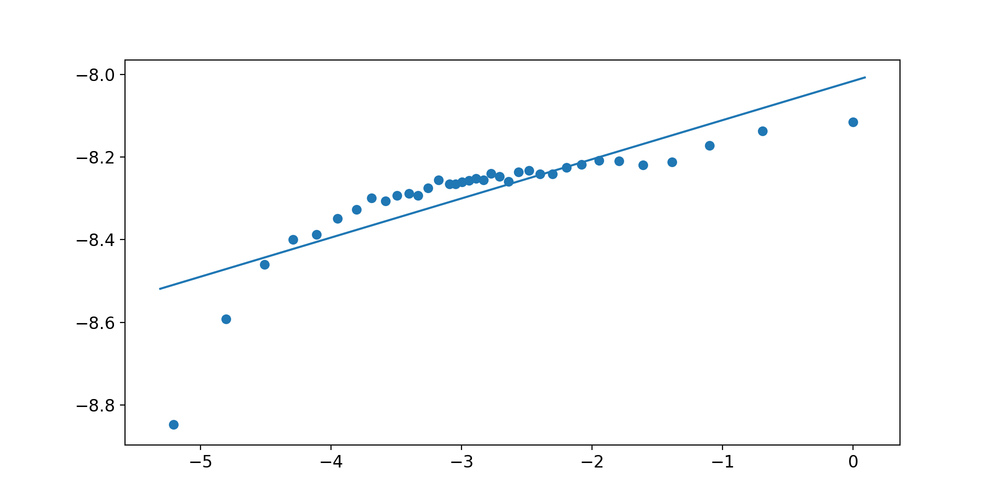

----------------------
---График для кластера: 46


<IPython.core.display.Javascript object>


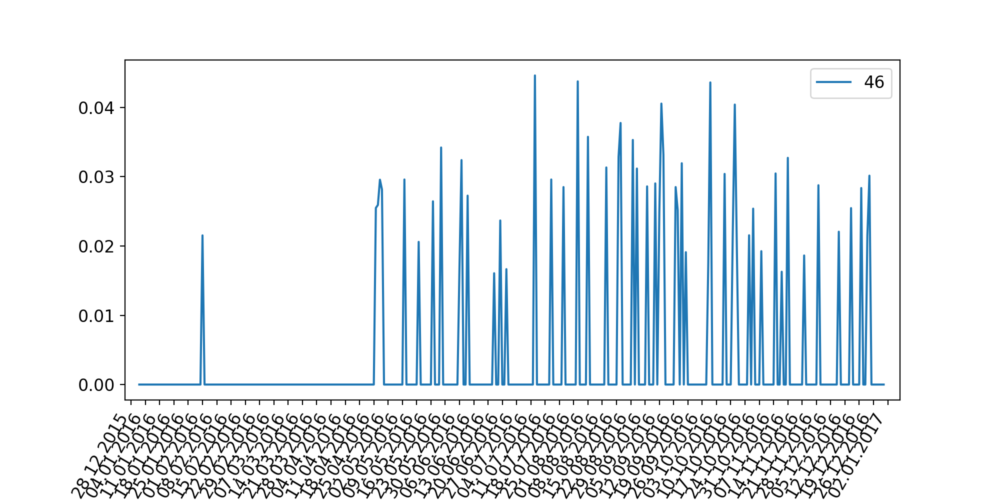

cluster: 46, 10 из 103 новостей:
	 Власти нашли способ сэкономить на пенсионерах еще 55 млрд руб.
	 Правительство отказалось от идеи снизить температуру горячей воды в домах на 10 градусов
	 Медведев пообещал проиндексировать пенсии на размер инфляции
	 Индексацию отложить
	 Замена индексации пенсий на разовую выплату порадовала 3% россиян
	 Голодец объяснила, кому из пенсионеров положена выплата в пять тысяч рублей
	 Минфину предложили не выплачивать пенсии работающим и старым россиянам
	 Голодец: на выплату военным пенсионерам потребуется 5 миллиардов
	 Минфин предложил новый способ сэкономить на работающих пенсионерах
	 Вторую индексацию пенсий в этом году заменят разовой выплатой
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 5.0296804609631554e-05, ln(variance): -9.897569009523968, ln(m): -5.209486152841421)
mi: 1/122, variance: 5.914020552969779e-05, ln(variance): -9.735599568238275, ln(m): -4.804021044733257)
mi: 1/91, variance: 7.734751508237073e-05, ln(var

<IPython.core.display.Javascript object>


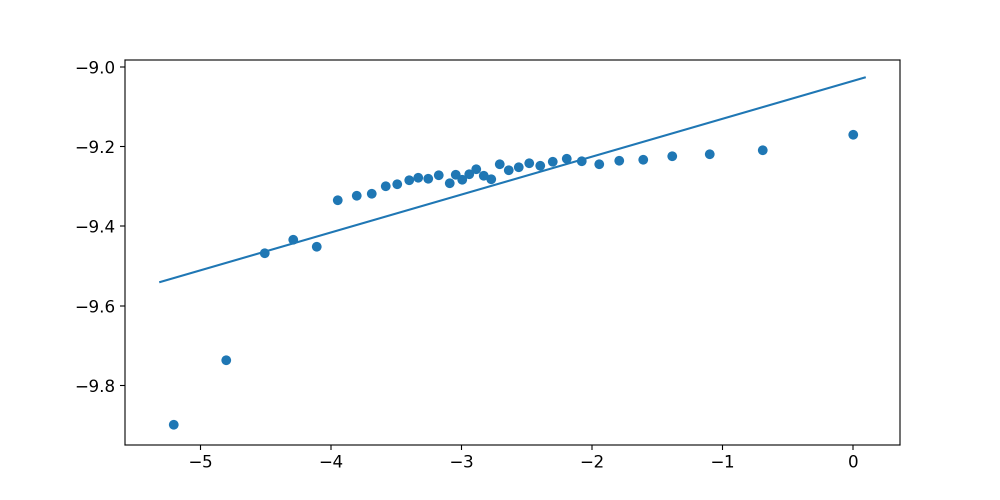

----------------------
---График для кластера: 87


<IPython.core.display.Javascript object>


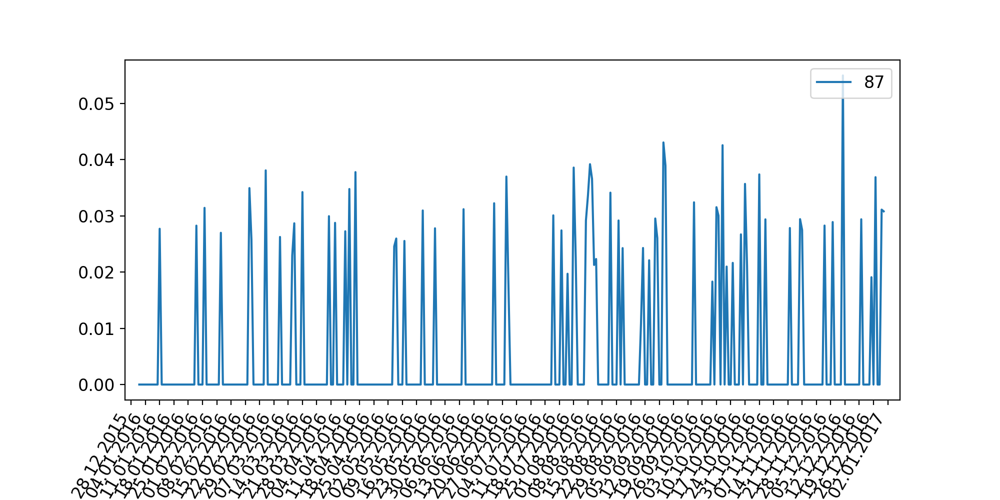

cluster: 87, 10 из 117 новостей:
	 Парламент Турции ратифицировал соглашение с Россией по «Турецкому потоку»
	 Керри обеспокоен строительством "Северного потока — 2"
	 Еврокомиссия одобрила строительство газопровода через Грецию в ЕС
	 Братья поневоле: Как Украина помогла России с "Турецким потоком"
	 СМИ: Украина призовёт Европу вдвое сократить поставки российского газа
	 "Нафтогаз" начал считать потери после соглашения по "Турецкому потоку"
	 Москва и Анкара заключили соглашение по «Турецкому потоку»
	 Россия назвала условие продления "Турецкого потока" на территорию Евросоюза
	 Транзит российского газа через Украину в декабре снизился на 19%
	 «Газпром» анонсировал новый газопровод по дну Черного моря
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 7.074571470319534e-05, ln(variance): -9.556418592841482, ln(m): -5.209486152841421)
mi: 1/122, variance: 9.118759314947984e-05, ln(variance): -9.302591710165906, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.0001014

<IPython.core.display.Javascript object>


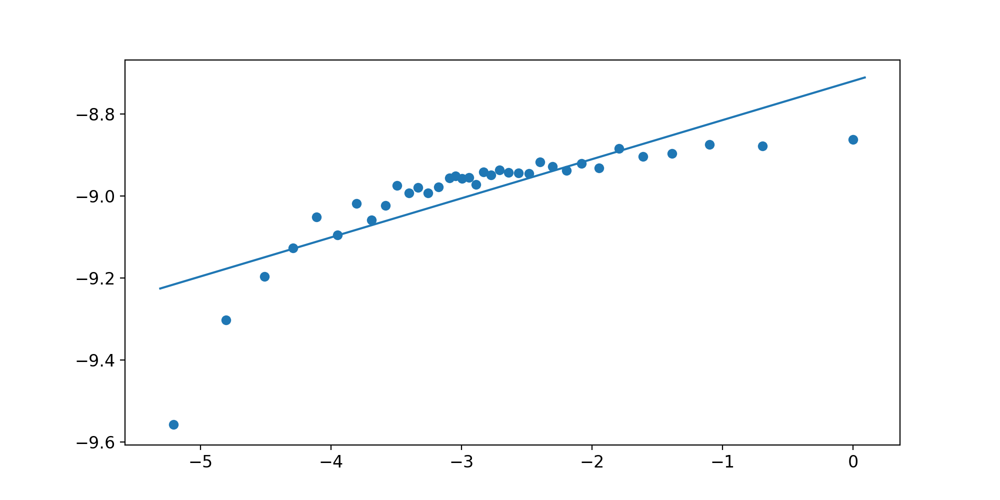

----------------------
---График для кластера: 24


<IPython.core.display.Javascript object>


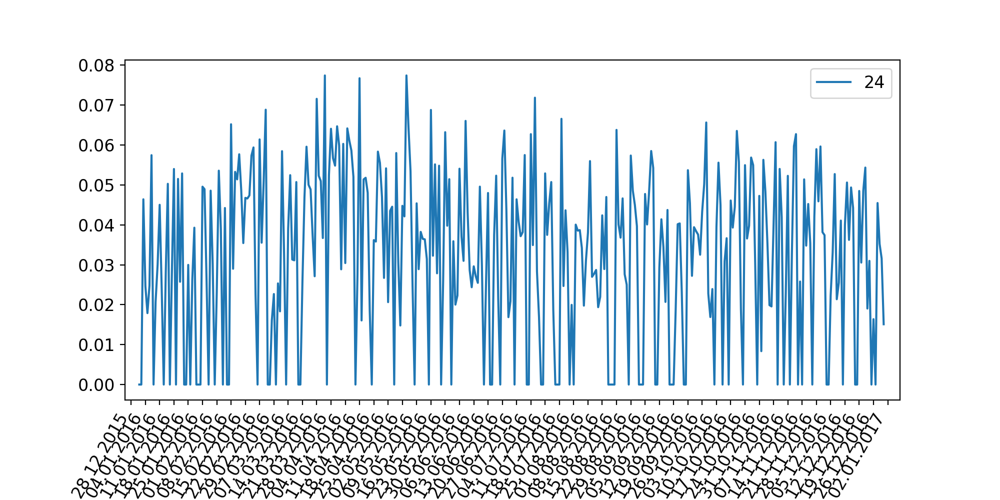

cluster: 24, 10 из 922 новостей:
	 В Росатоме обвинили Украину в нарушении контракта с Россией
	 Под защитой миллиардов
	 СМИ назвали возможного покупателя бизнеса TNS в России
	 Громкое молчание ягнят
	 Забили на стрелку
	 Bulgari заявила о планах открыть люксовый отель в России
	 Париж пообещал «пойти до конца» в вопросе налогов для зарубежных компаний
	 Tesla презентовала цельную солнечную батарею в виде крыши
	 Apple впервые сообщила о снижении объема продаж iPhone
	 Вице-президент "Алросы" вынес второго вице-президента из рухнувшей шахты
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.00021050266027537715, ln(variance): -8.466012267033918, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.0002706932964670568, ln(variance): -8.214524125348255, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.0003351321817769729, ln(variance): -8.000985531493878, ln(m): -4.51085950651685)
mi: 1/73, variance: 0.000346017879133807, ln(variance): -7.969020110444465, ln(m): -4.2904

<IPython.core.display.Javascript object>


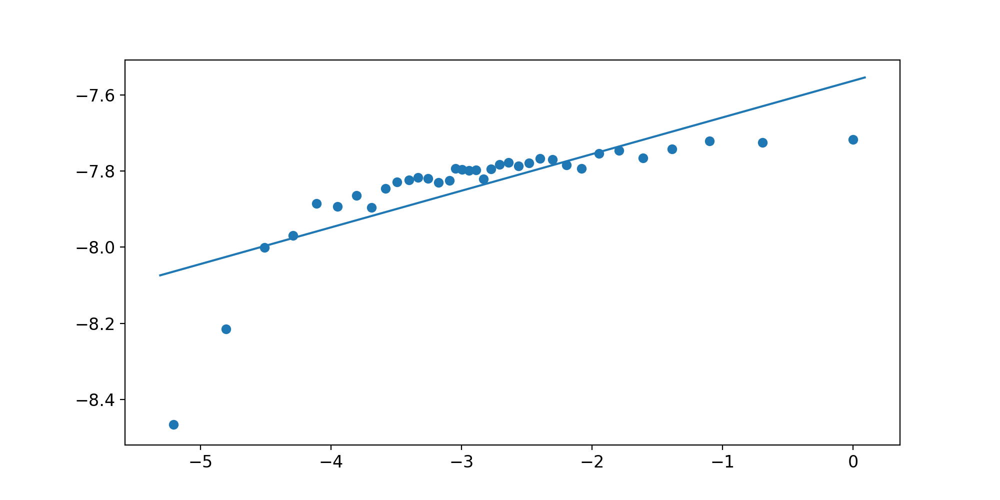

----------------------
---График для кластера: 235


<IPython.core.display.Javascript object>


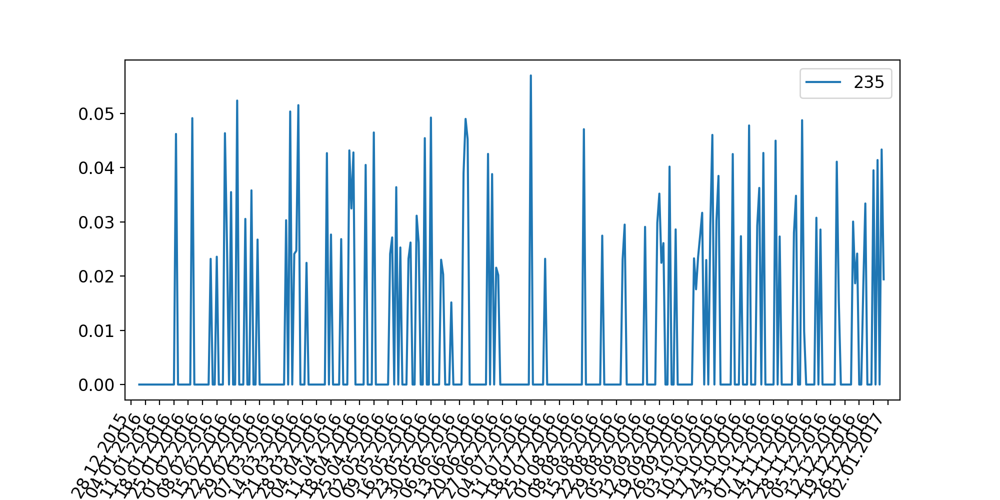

cluster: 235, 10 из 172 новостей:
	 Работа по "украинской" схеме. Сможет ли Белоруссия прожить без российской нефти?
	 Минск довели до Крыма
	 Кот-баян и белорусская оппозиция
	 Лавров: У нас, в Союзном государстве, "палочной дисциплины" не существует
	 КГБ задержал белорусского олигарха
	 Дворкович: Россия ждет от Белоруссии полной оплаты за газ
	 Белоруссия отменила повышение тарифов на транзит российской нефти
	 Исчезновение Коли Лукашенко объяснили занятиями музыкой и спортом
	 Лукашенко угостил Медведева берёзовым соком
	 Россия потеряет 25 миллиардов рублей из-за скидки на газ для Белоруссии
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.00011305786322041844, ln(variance): -9.087610806414403, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.00014146642356168337, ln(variance): -8.863448158355272, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.00017014108728719238, ln(variance): -8.678882539892742, ln(m): -4.51085950651685)
mi: 1/73, variance: 0.0001830137

<IPython.core.display.Javascript object>


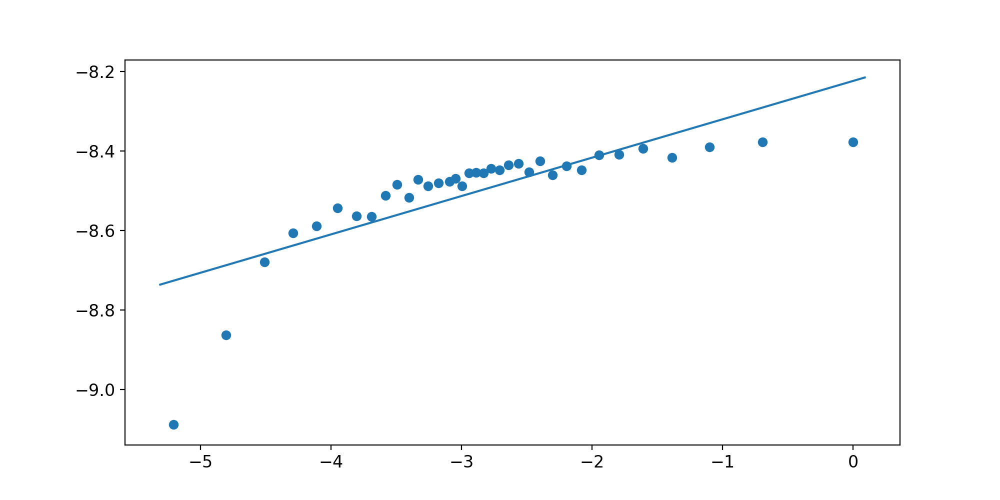

----------------------
---График для кластера: 224


<IPython.core.display.Javascript object>


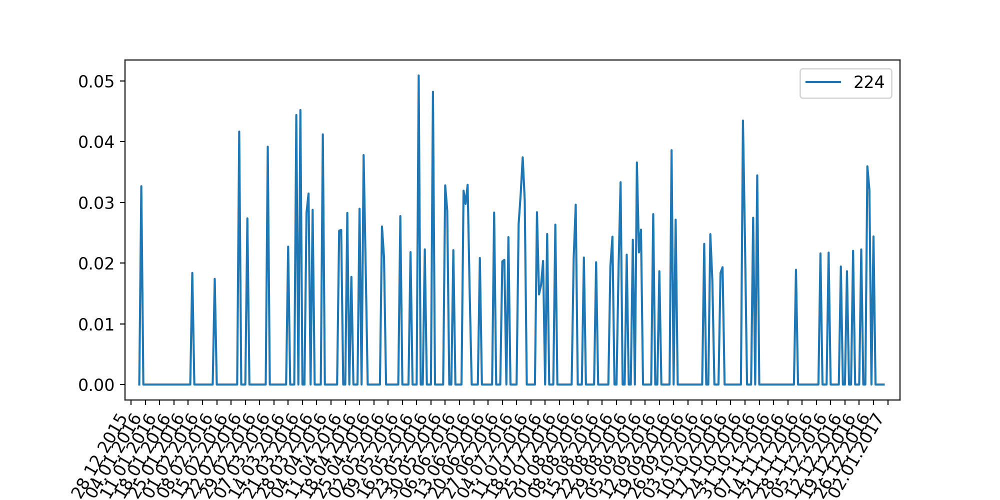

cluster: 224, 10 из 159 новостей:
	 Кара за Крымский мост: чей бизнес подпал под новые санкции США
	 Ключевой момент строительства моста через Керченский пролив — началось возведение судоходной арки
	 Кремль: все сложности при строительстве Крымского моста будут урегулированы
	 Иностранные журналисты посетили стройплощадку Керченского моста
	 Пешеходный мост рухнул на трассу, соединяющую Лондон с Евротоннелем
	 В Финляндии строят самый большой в мире ледяной мост по проекту Леонардо да Винчи
	 Стрельба в Анкаре: перекрыты мосты, подняты истребители
	 Запуск поездов по Керченскому мосту отложили до декабря 2019 года
	 Власти Крыма надеются, что Киев оценит преимущества Керченского моста
	 В Киеве нашли три способа остановить строительство Крымского моста
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 6.618696970476709e-05, ln(variance): -9.623026946649595, ln(m): -5.209486152841421)
mi: 1/122, variance: 9.034942662911345e-05, ln(variance): -9.311825887054491, ln(m):

<IPython.core.display.Javascript object>


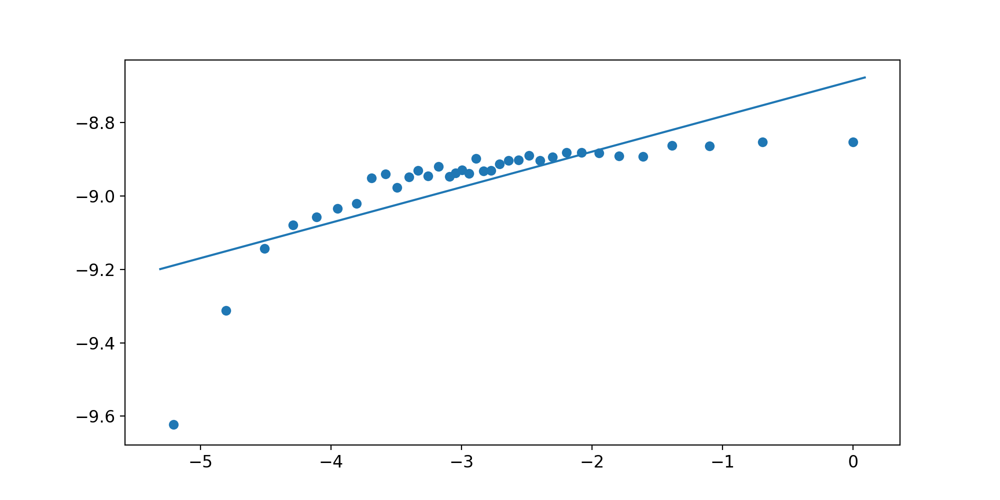

----------------------
---График для кластера: 203


<IPython.core.display.Javascript object>


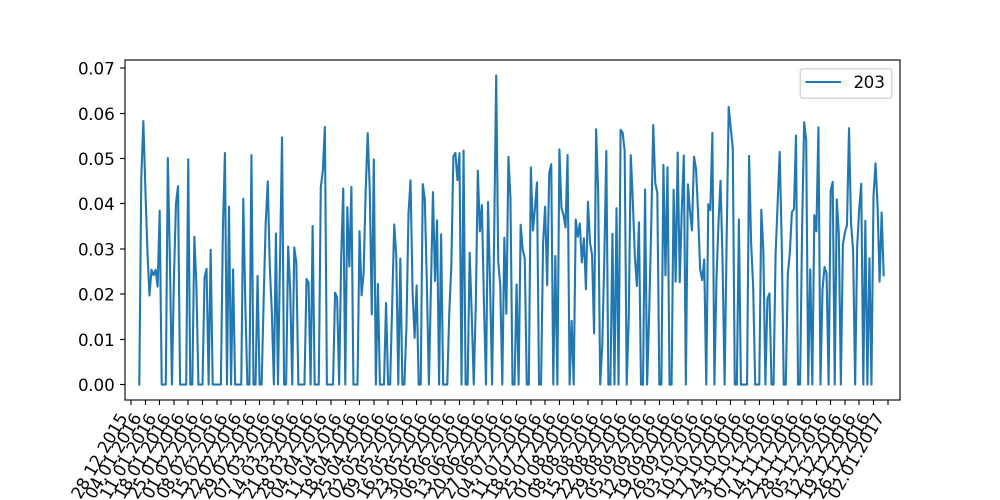

cluster: 203, 10 из 504 новостей:
	 Российской победительнице Олимпиады, продававшей машину, будет оказана помощь
	 Запрета продавать свои машины не будет
	 Иномарка бизнес-класса стала самым популярным авто с пробегом на Кавказе
	 Момент возгорания четырёх грузовиков в Санкт-Петербурге попал на видео
	 Из водителей – в пилоты: кто производит летающие автомобили
	 В Германии женщина въехала на машине в метро, перепутав его с парковкой. Видео
	 СМИ: дочь актера Пола Уокера отсудила более $10 млн за смерть отца
	 Как подготовить автомобиль к зиме
	 В Казахстане бизнесмен продаёт Tesla S менее чем за тысячу рублей
	 Лена Ленина первой купила себе Ладу XRAY
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 0.00015734148426043486, ln(variance): -8.7570920556487, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.00024135319157725534, ln(variance): -8.329249172090824, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.00026291730807291217, ln(variance): -8.243670993199922, ln(

<IPython.core.display.Javascript object>


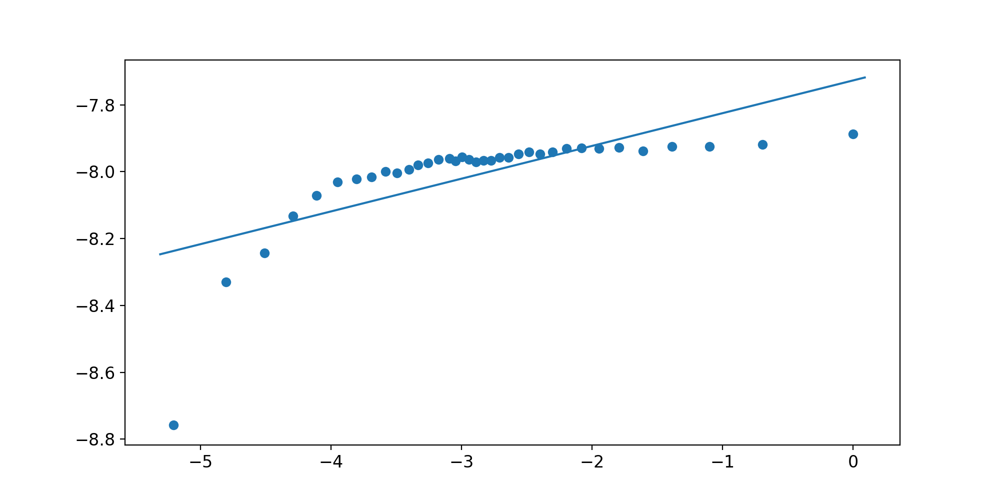

----------------------


In [74]:
for c_label, c_news, dd_cos, h_res in first_20:
    print("---График для кластера: %s" % (c_label))
    plot_cos_centroid(dd_cos, start_year, end_year, c_label)
    print_news(c_news, 10, c_label)
    hist = SelfSimilarityHirst()
    h_res = hist.compute(list(dd_cos.items()))
    print("---Результаты анализа самоподобия кластера")
    h_res.print_result()
    h_res.plot()
    print("----------------------")

# Последние 20 кластеров

---График для кластера: 30


/anaconda/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


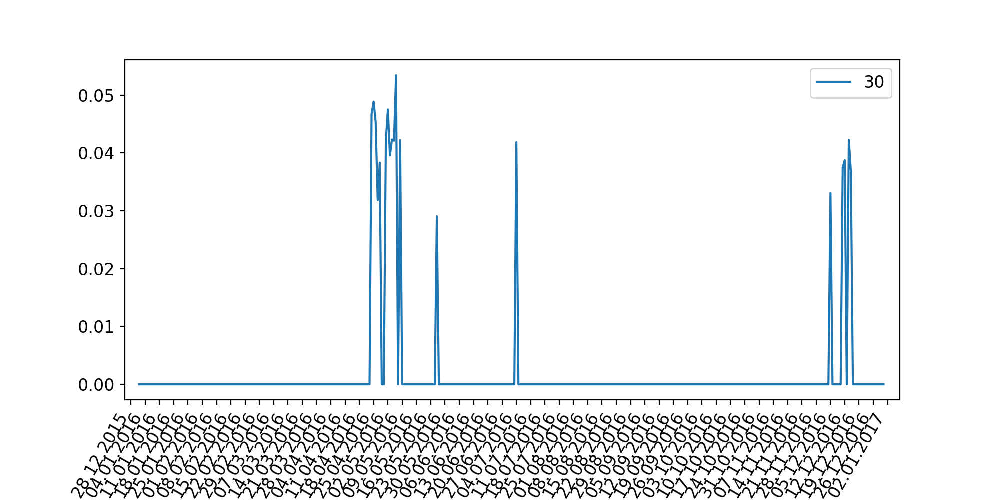

cluster: 30, 10 из 147 новостей:
	 За информацию об убийстве семьи полицейского под Сызранью пообещали три миллиона
	 Бастрыкин приехал на место убийства семьи Гошта
	 СК раскрыл подробности убийства семьи под Сызранью
	 Депутат от Самарской области Хинштейн: Экс-главу полиции Сызрани убили из мести
	 Экс-начальника сызранской полиции убили гастролёры
	 Убийцы Андрея Гошта сразу воспользовались его банковской картой
	 Подозреваемых в убийстве семьи Гошт привезли на место преступления
	 Сапёры не нашли взрывчатку на месте убийства семьи полицейского
	 В Самарской области убили экс-главу полиции Сызрани с семьей
	 Жестокое нападение на полицейского и его жену в Самарской области: кто и за что мог наказать подполковника
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 2.017575744167959e-05, ln(variance): -10.811028800935329, ln(m): -5.209486152841421)
mi: 1/122, variance: 2.2639319033209425e-05, ln(variance): -10.695822383120099, ln(m): -4.804021044733257)
mi: 1/91, var

<IPython.core.display.Javascript object>


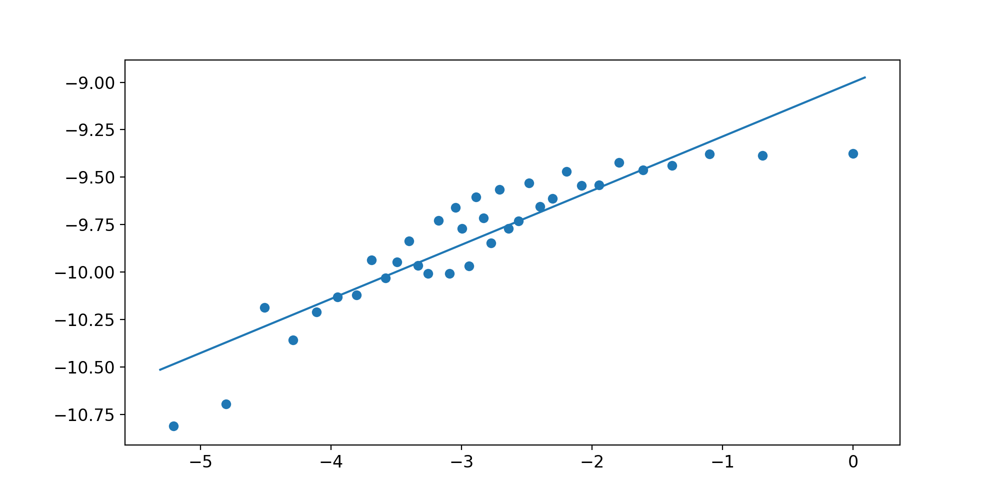

----------------------
---График для кластера: 214


<IPython.core.display.Javascript object>


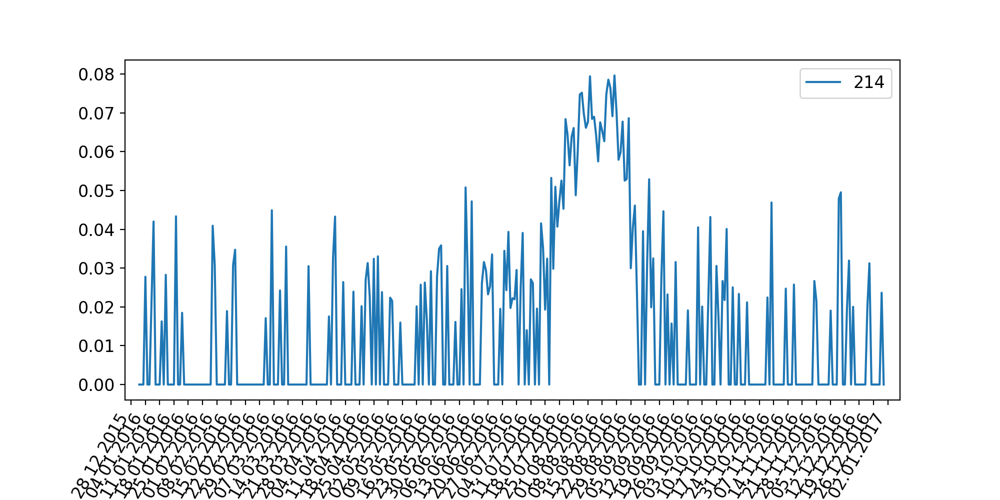

cluster: 214, 10 из 876 новостей:
	 Дмитрий Медведев поддержал российскую сборную на Олимпиаде в Рио
	 У британских пловцов в Рио украли девять сумок с инвентарем и одеждой
	 Почему сердце Фелпса не должно разрываться из-за Юлии Ефимовой
	 5 самых эмоциональных олимпийцев этой недели
	 Спортсмены из США пользуются особыми привилегиями в Рио
	 В Бразилии застрелили ягуара, участвовавшего в эстафете олимпийского огня
	 Улыбайтесь, вас снимают на фотофинише!
	 Олимпийских спортсменов сравнили с порноактерами
	 Оргкомитет Игр в Рио извинился за недоразумение с китайскими флагами
	 Жители Рио массово покидают столицу Олимпиады перед церемонией открытия
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 9.479817152805731e-05, ln(variance): -9.263760436568028, ln(m): -5.209486152841421)
mi: 1/122, variance: 0.00012035185829430961, ln(variance): -9.025090953104009, ln(m): -4.804021044733257)
mi: 1/91, variance: 0.00013774879902779717, ln(variance): -8.890078828460748, ln(m): -

<IPython.core.display.Javascript object>


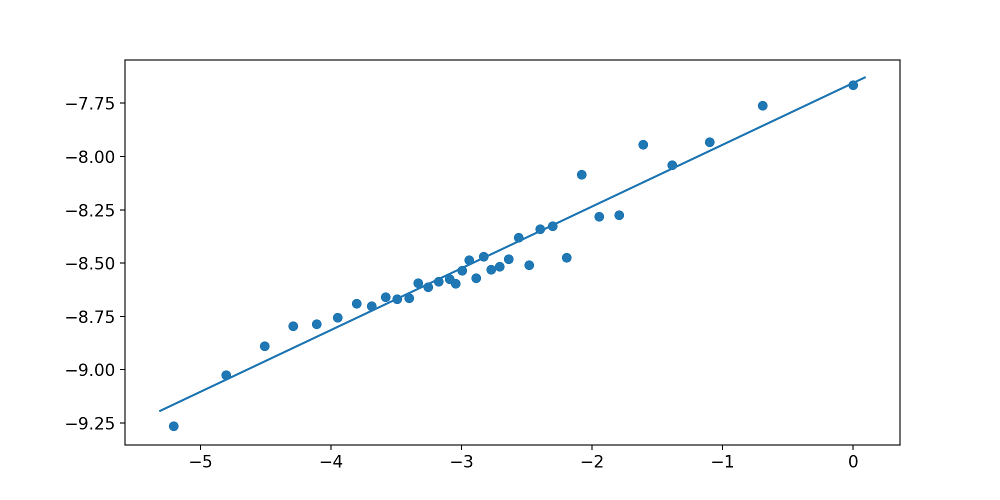

----------------------
---График для кластера: 11


<IPython.core.display.Javascript object>


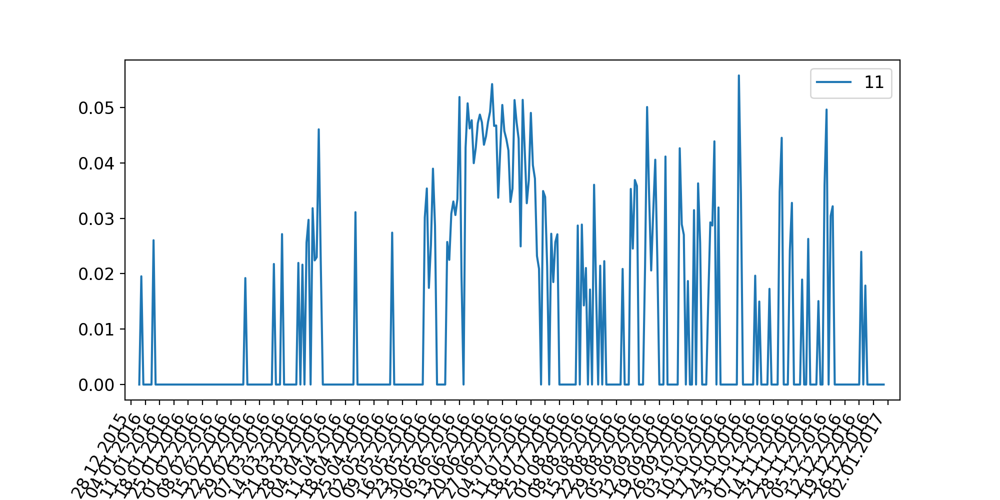

cluster: 11, 10 из 486 новостей:
	 Станислав Черчесов: в сборной России профессиональная атмосфера
	 Тренер сборной Англии по футболу подал в отставку после поражения от исландцев
	 Вылет сборной России с Евро-2016: финский огурец предупреждал
	 Евро-2016: российские футболисты просят не впадать в панику
	 Артём Дзюба поставил рекорд Евро-2016 по числу единоборств, проведённых за матч
	 Почему мы потеряли футбольную сборную России на два года
	 Чудеса фотошопа: Певица Шакира забила гол на Евро-2016
	 Мутко: расстраиваться из-за поражения российских футболистов не стоит
	 Готовые бесплатно играть за Россию любители вызвали на матч сборную по футболу
	 10 главных матчей сборных Бельгии и Уэльса
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 4.8386408201703444e-05, ln(variance): -9.936291605958502, ln(m): -5.209486152841421)
mi: 1/122, variance: 7.95293676502936e-05, ln(variance): -9.439384200110789, ln(m): -4.804021044733257)
mi: 1/91, variance: 9.300107624492548e-05

<IPython.core.display.Javascript object>


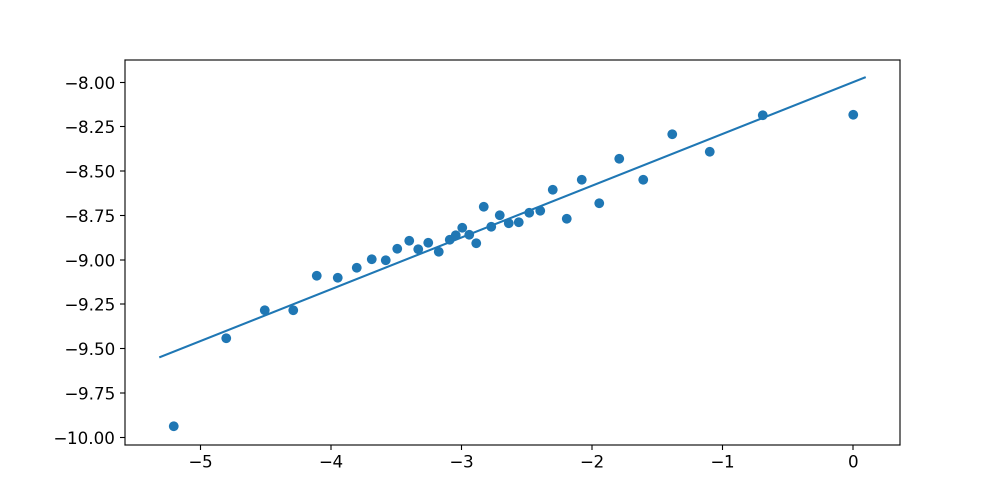

----------------------
---График для кластера: 263


<IPython.core.display.Javascript object>


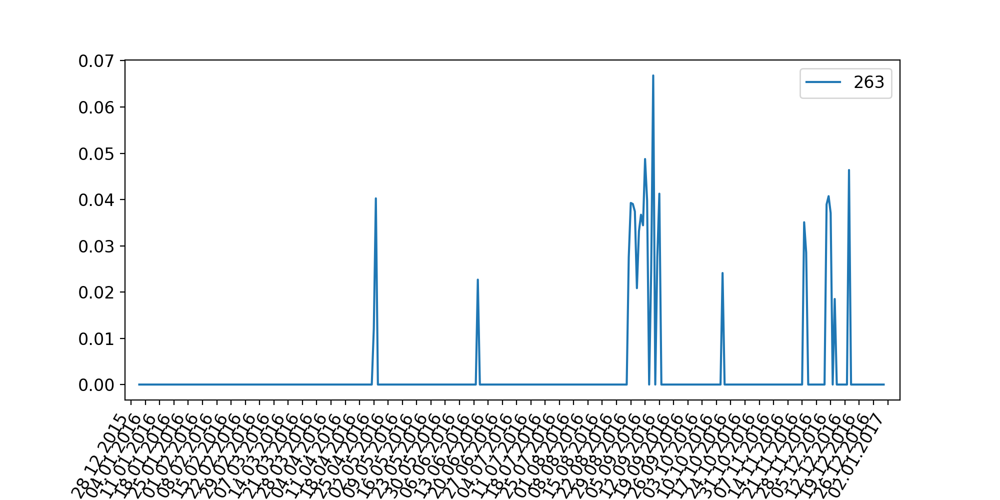

cluster: 263, 10 из 147 новостей:
	 Он не был ни демократом, ни сатрапом
	 СМИ сообщили об отсутствии Гульнары Каримовой на похоронах отца
	 Страх за будущее: что ждет Узбекистан после окончания эпохи Каримова
	 Узбекистан официально объявил о смерти Ислама Каримова
	 Узбекистан перестает быть государством-затворником
	 Умер президент Узбекистана Ислам Каримов
	 Путин и Медведев соболезнуют народу Узбекистана и родным Каримова
	 Дочь президента Узбекистана рассказала о кровоизлиянии в мозг у отца
	 Reuters узнал о смерти президента Узбекистана Ислама Каримова
	 Шавкат Мирзиеев победил на выборах президента Узбекистана
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 1.7162013896251614e-05, ln(variance): -10.972812110869173, ln(m): -5.209486152841421)
mi: 1/122, variance: 2.9185190551813504e-05, ln(variance): -10.441849150228807, ln(m): -4.804021044733257)
mi: 1/91, variance: 2.7831792364308333e-05, ln(variance): -10.489331580464812, ln(m): -4.51085950651685)
mi: 1/73

<IPython.core.display.Javascript object>


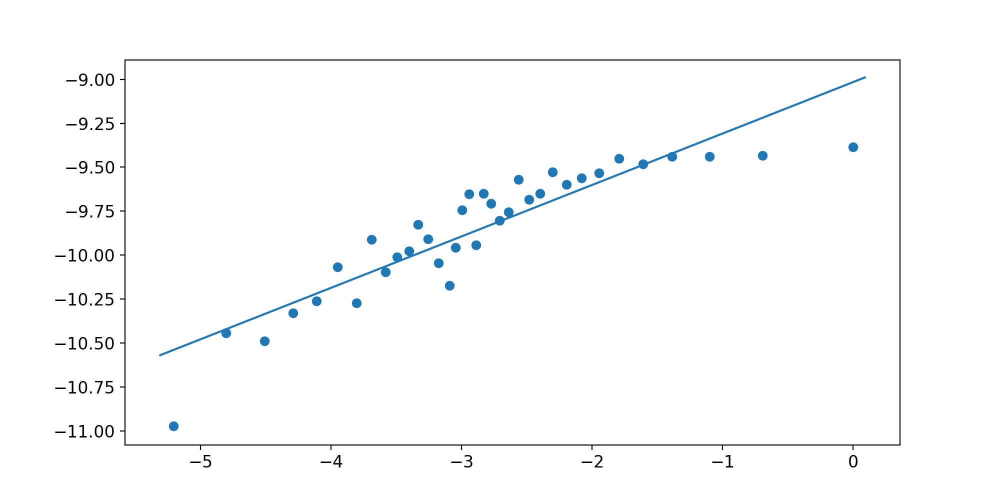

----------------------
---График для кластера: 251


<IPython.core.display.Javascript object>


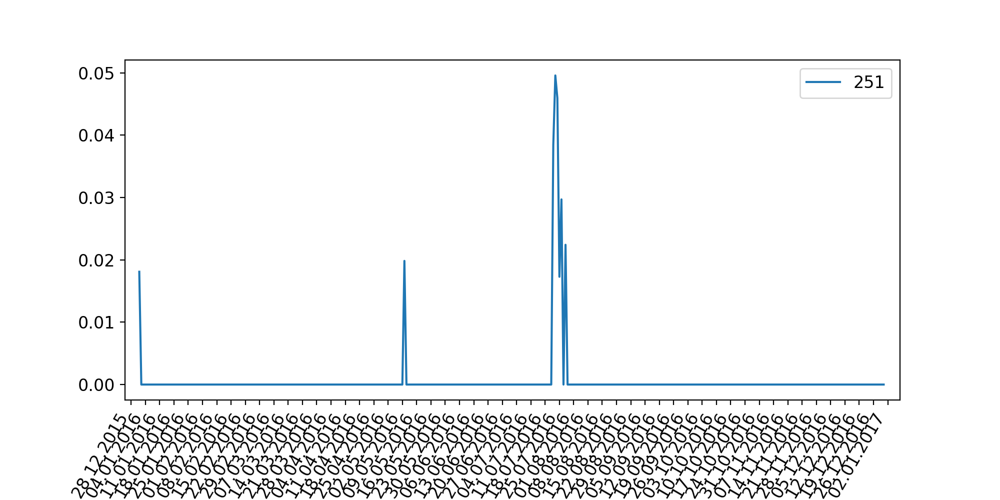

cluster: 251, 10 из 147 новостей:
	 Полиция Мюнхена опровергла данные о стрельбе на Карлсплатц
	 AFP: При стрельбе в Мюнхене один человек погиб, 10 пострадали
	 Пользователи Инстаграма и Твиттера создали десятки картинок в поддержку Мюнхена
	 Полиция назвала стрельбу в торговом комплексе в Мюнхене терактом
	 Очевидцы сообщают о стрельбе на Карлсплатц в Мюнхене
	 Мюнхенский стрелок ранее не попадал в поле зрения полиции
	 Мюнхенский стрелок был не террористом, а сумасшедшим
	 Мюнхенский стрелок: «Вы издевались надо мной семь лет, теперь я купил пистолет, чтобы убивать вас»
	 Мюнхенский стрелок заманил своих жертв на место убийства по Интернету
	 Над стрелком из Мюнхена издевались в школе
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 3.91731878026687e-06, ln(variance): -12.450103122811905, ln(m): -5.209486152841421)
mi: 1/122, variance: 7.021869284213046e-06, ln(variance): -11.8664810955703, ln(m): -4.804021044733257)
mi: 1/91, variance: 7.411444915535089e-06, ln(va

<IPython.core.display.Javascript object>


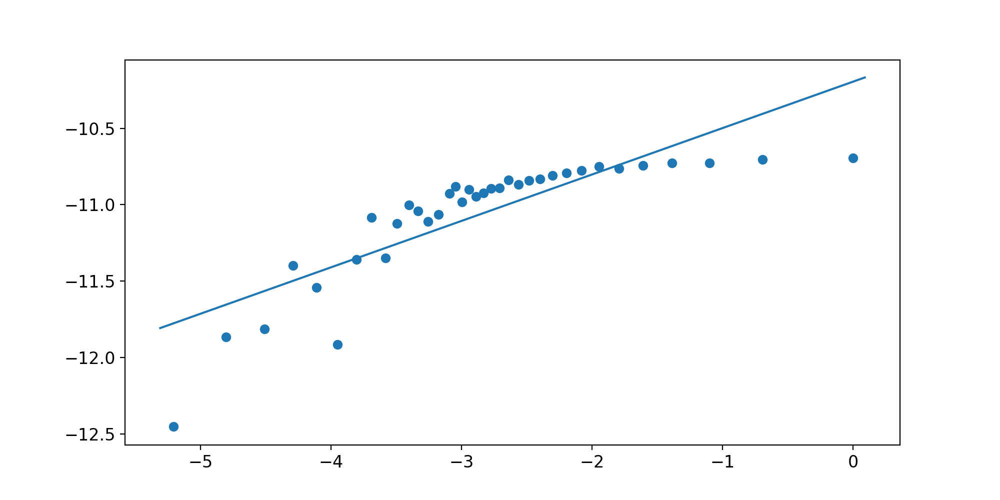

----------------------
---График для кластера: 291


<IPython.core.display.Javascript object>


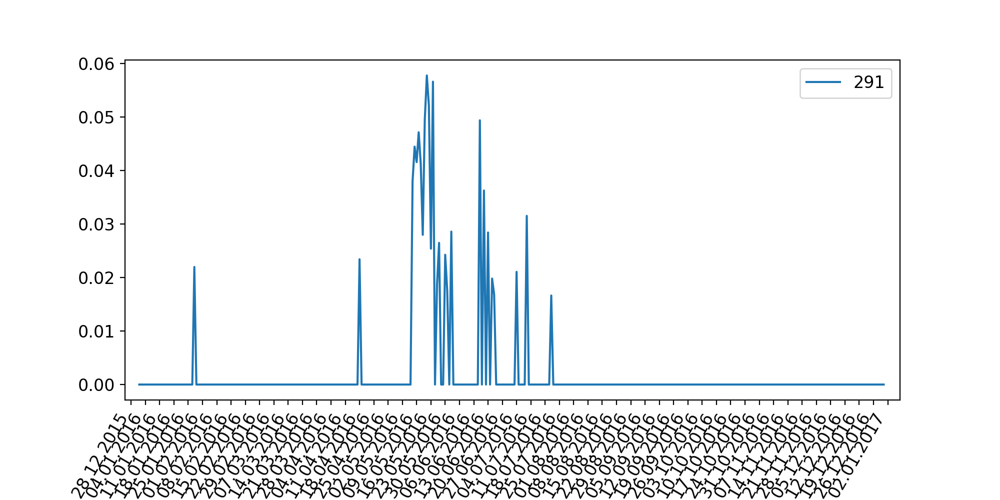

cluster: 291, 10 из 140 новостей:
	 «Коммерсантъ» назвал новую версию массовой драки на Хованском кладбище
	 Полиция назвала причину массовой драки на Хованском кладбище
	 Руководство полиции ТиНАО отправлено в отставку после побоища на Хованском
	 Работники ритуальных служб сообщили подробности драки на Хованском кладбище
	 Ритуальное буйство
	 Назначены новые начальники Хованского кладбища
	 Число участников боя на кладбище в Москве возросло до 500
	 Очевидец о массовой драке на Хованском кладбище: "Когда омоновцы окружили дерущихся, уже выносили одного неживого"
	 50 человек задержаны по делу о перестрелке на кладбище в Москве
	 Макарьев: На Хованском кладбище была организована засада
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 1.7954111175748266e-05, ln(variance): -10.927691434393838, ln(m): -5.209486152841421)
mi: 1/122, variance: 2.663095990694754e-05, ln(variance): -10.533436112714194, ln(m): -4.804021044733257)
mi: 1/91, variance: 2.9046202516065945e-05,

<IPython.core.display.Javascript object>


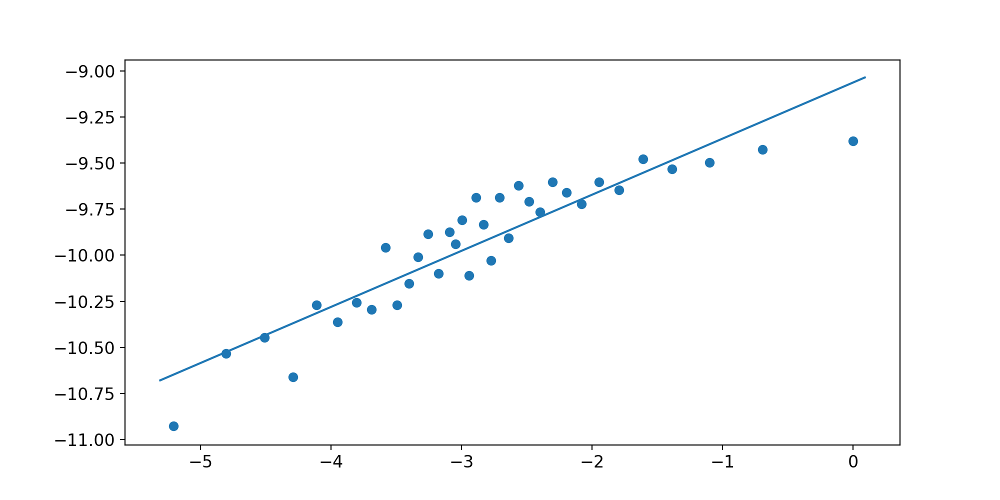

----------------------
---График для кластера: 120


<IPython.core.display.Javascript object>


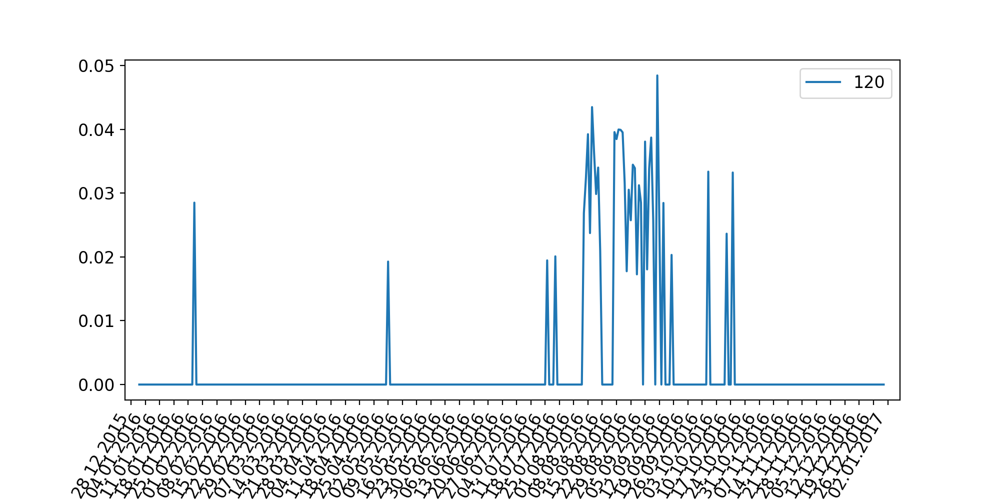

cluster: 120, 10 из 172 новостей:
	 Нечестная игра: отстраненные паралимпийцы России обвиняют Филипа Крэйвена
	 Паралимпийский комитет: Государство нам помогает, но очень мало
	 CAS не допустил российских спортсменов к Паралимпиаде в Рио
	 Guardian: россиян не пустят на Паралимпиаду
	 Чиновники МПК в бешенстве: за российский триколор белорусского паралимпийца накажут
	 Жуков: IPC, очевидно, не выдержал политического давления
	 Минспорта Подмосковья: Паралимпийцы смогут оспорить отстранение самостоятельно
	 Путин: В России пройдут специальные соревнования для паралимпийцев
	 В Подмосковье стартуют соревнования российских паралимпийцев
	 Это политика: как мир отреагировал на отстранение российских паралимпийцев
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 1.523778094991681e-05, ln(variance): -11.091732625268335, ln(m): -5.209486152841421)
mi: 1/122, variance: 2.4284253025362462e-05, ln(variance): -10.625682441323484, ln(m): -4.804021044733257)
mi: 1/91, variance: 2

<IPython.core.display.Javascript object>


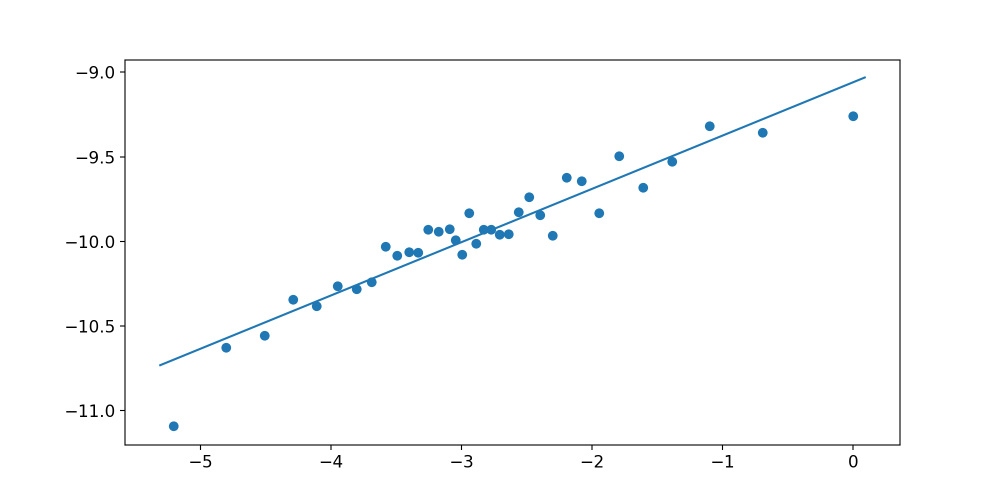

----------------------
---График для кластера: 210


<IPython.core.display.Javascript object>


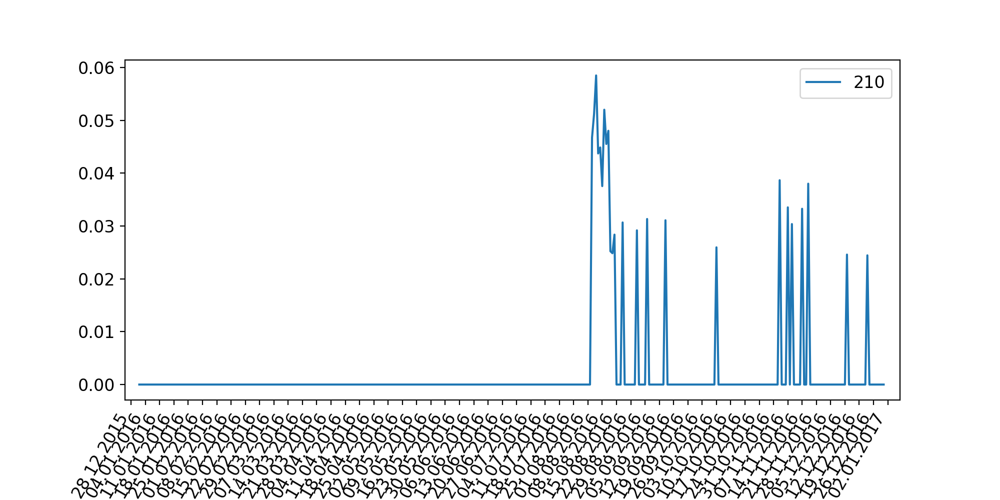

cluster: 210, 10 из 206 новостей:
	 Совбез ООН обсудит ситуацию в Крыму
	 Диверсанты в Крыму назвали заказчиками терактов разведку Украины
	 Киев обратился к мировому сообществу из-за обвинений со стороны Москвы
	 В Крыму назвали истинную причину подготовки терактов на полуострове
	 Диверсантов в Крыму обнаружили, когда они уже заминировали дамбу
	 Минобороны Украины открестилось от крымских диверсантов
	 СМИ выяснили подробности боев с украинскими диверсантами в Крыму
	 Украину предложили исключить из ООН и ОБСЕ
	 Украина пожаловалась в ООН на визит Путина в Крым
	 «Очень опасная игра»: как Москва ответит на действия диверсантов в Крыму
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 1.7179804752369872e-05, ln(variance): -10.971776006294057, ln(m): -5.209486152841421)
mi: 1/122, variance: 1.9830718007841898e-05, ln(variance): -10.828278407926602, ln(m): -4.804021044733257)
mi: 1/91, variance: 3.45303008800221e-05, ln(variance): -10.273673333017305, ln(m): -4.510859

<IPython.core.display.Javascript object>


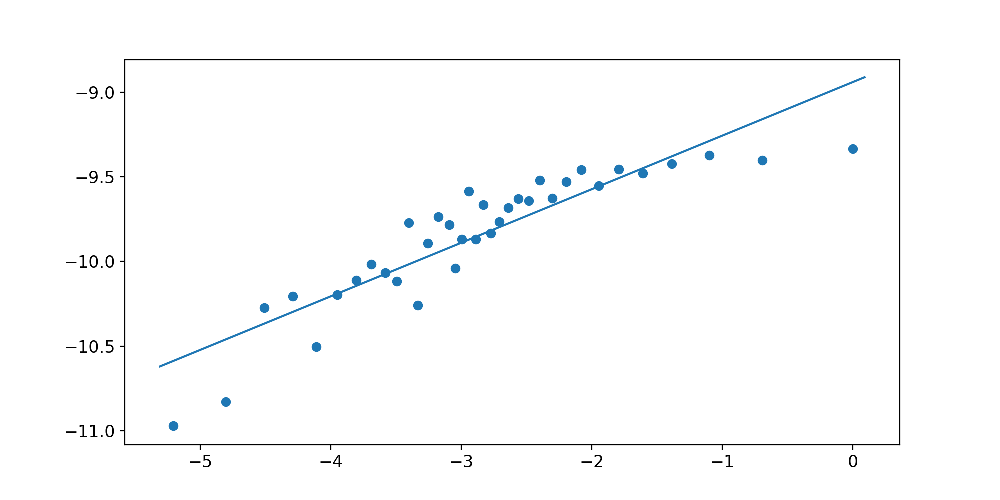

----------------------
---График для кластера: 2


<IPython.core.display.Javascript object>


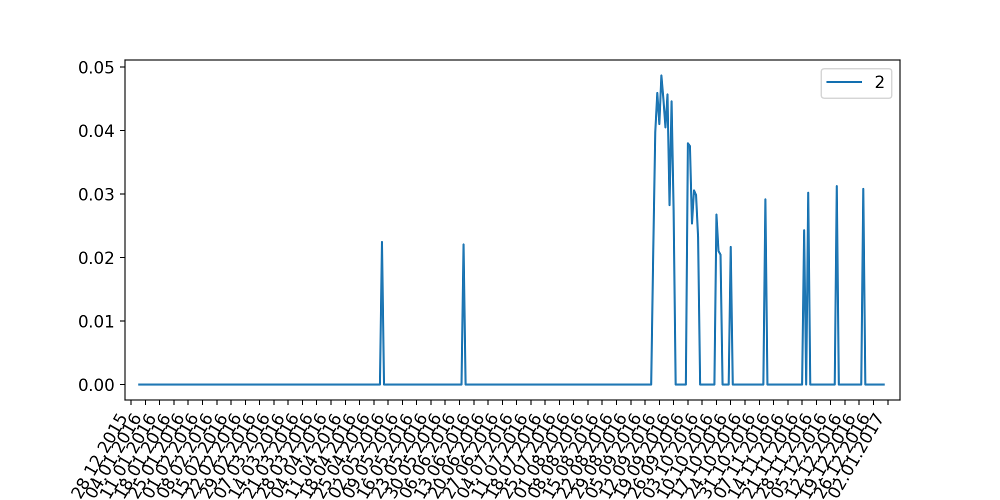

cluster: 2, 10 из 166 новостей:
	 Полковник Захарченко в списках не значится
	 СК нашёл у семьи Захарченко пять элитных квартир в Москве
	 В Сбербанке рассказали о планах на изъятые у полковника Захарченко 9 миллиардов
	 Антикоррупционный комитет МВД может быть ликвидирован
	 Сбербанк рассказал, что в ближайшее время будет с 9 млрд рублей Захарченко
	 СМИ связали дело полковника Захарченко с хищениями из РЖД
	 Судья арестовал Захарченко, отказавшись от 70 миллионов
	 Эксперт по уголовному праву: "Захарченко интересен только размером суммы, а на самом деле - обычная история"
	 СК выяснит, брал ли взятки полковник Захарченко и откуда у него миллиарды
	 ФСБ обыскала антикоррупционное управление МВД. Задержаны два сотрудника
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 1.3721892939675649e-05, ln(variance): -11.196517975819319, ln(m): -5.209486152841421)
mi: 1/122, variance: 2.072585986421338e-05, ln(variance): -10.78412836857735, ln(m): -4.804021044733257)
mi: 1/91, 

<IPython.core.display.Javascript object>


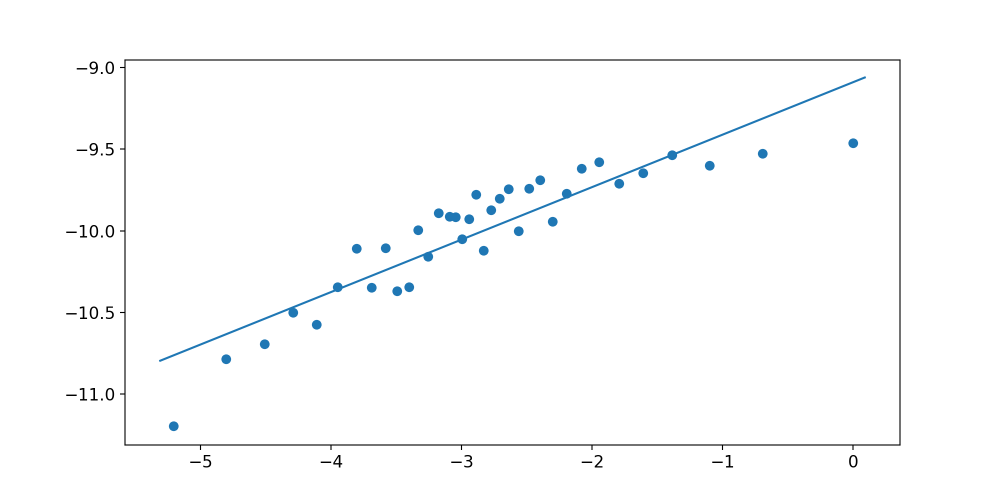

----------------------
---График для кластера: 93


<IPython.core.display.Javascript object>


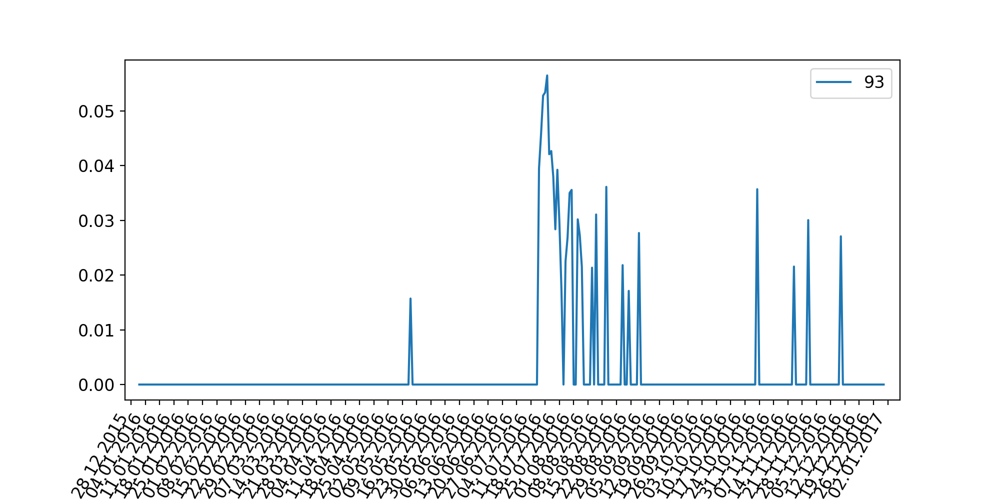

cluster: 93, 10 из 339 новостей:
	 В Стамбуле первая после попытки переворота ночь прошла спокойно
	 Бывший главком турецких ВВС признался в организации госпереворота
	 Сдавшихся на Босфорском мосту военных публично выпороли
	 Жириновский сравнил переворот в Турции с детским спектаклем в ТЮЗе
	 В Турции после попытки госпереворота задержано более 100 генералов и адмиралов
	 Чартеры в Турцию не возобновятся до конца года
	 Число жертв попытки переворота в Турции возросло до 90 человек, 1154 ранены
	 Очевидец: В Анкаре ещё стреляют по сторонникам Эрдогана
	 Премьер Турции: Более 120 человек арестованы за попытку госпереворота
	 Эрдоган выступил перед сторонниками возле аэропорта в Стамбуле
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 1.5303360695364556e-05, ln(variance): -11.087438100394335, ln(m): -5.209486152841421)
mi: 1/122, variance: 2.0442440000893222e-05, ln(variance): -10.79789742593265, ln(m): -4.804021044733257)
mi: 1/91, variance: 2.4336297187628312e-05,

<IPython.core.display.Javascript object>


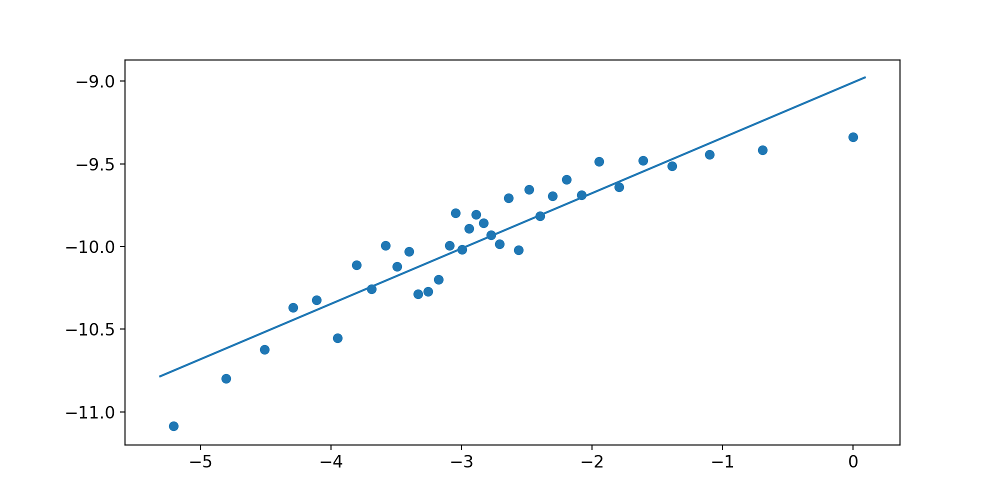

----------------------
---График для кластера: 86


<IPython.core.display.Javascript object>


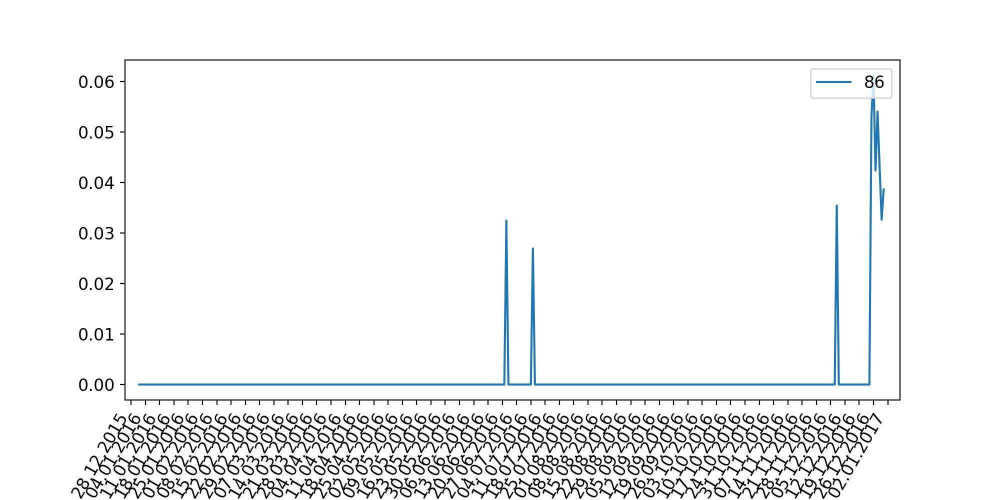

cluster: 86, 10 из 150 новостей:
	 Невестка Елизаветы Глинки: Наша мама была Героем
	 У командира Ту-154, погибшего над Черным морем, остались трое детей
	 Американцы спели гимн РФ в Нью-Йорке в память о жертвах крушения Ту-154
	 Доктор Лиза занимается детьми Донбасса и не пойдет на госслужбу
	 Москалькова хотела лететь в Сирию с Лизой Глинкой, но отложила полет
	 Эксперт: второй самописец Ту-154 находится в отличном состоянии
	 Катастрофа Ту-154: мир скорбит, в Киеве "острят"
	 Доктор Лиза летела в Сирию, чтобы отвезти лекарства для больных детей
	 РПЦ: канонизируя Елизавету Глинку сейчас, мы лишим ее наших молитв
	 "Милосердие и сострадание работают сильнее любого оружия"
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 8.662138135274321e-06, ln(variance): -11.656548968026504, ln(m): -5.209486152841421)
mi: 1/122, variance: 1.1264841931508798e-05, ln(variance): -11.393824016001966, ln(m): -4.804021044733257)
mi: 1/91, variance: 1.2694925037461453e-05, ln(variance):

<IPython.core.display.Javascript object>


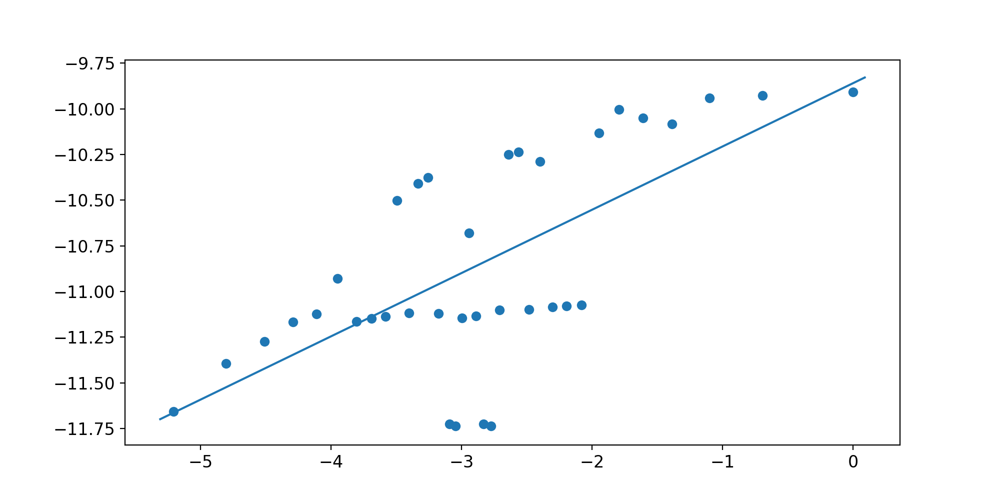

----------------------
---График для кластера: 8


<IPython.core.display.Javascript object>


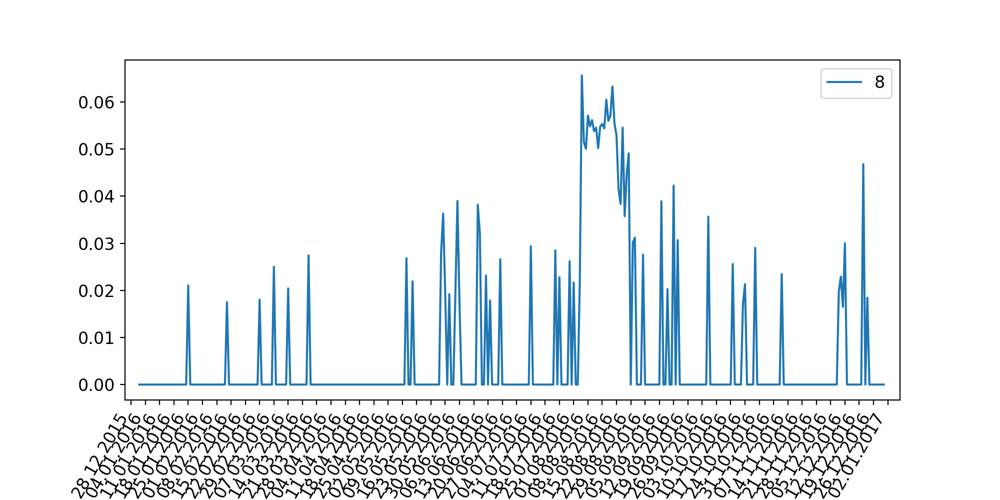

cluster: 8, 10 из 529 новостей:
	 Россия выиграла второе золото в художественной гимнастике на Олимпиаде
	 Тхэквондист Алексей Денисенко завоевал олимпийское серебро
	 Россия выиграла 19-ю золотую медаль на Олимпиаде в Рио-де-Жанейро
	 Российские гимнастки завоевали олимпийское "серебро"
	 У олимпийской чемпионки Яны Егорян во время поединка украли кошелек
	 Гимнастка Алия Мустафина завоевала бронзу Олимпиады в многоборье
	 Триумф в Берне: российские гимнасты победили на чемпионате Европы-2016
	 Российских олимпийцев встретили в Шереметьево лезгинкой
	 Волейболистки сборной России завершили олимпийский турнир, проиграв сербкам
	 МОК начал дисциплинарное разбирательство против 28 российских спортсменов
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 3.85781540847835e-05, ln(variance): -10.162824398059996, ln(m): -5.209486152841421)
mi: 1/122, variance: 5.580648630297798e-05, ln(variance): -9.793620453343733, ln(m): -4.804021044733257)
mi: 1/91, variance: 5.9801951781

<IPython.core.display.Javascript object>


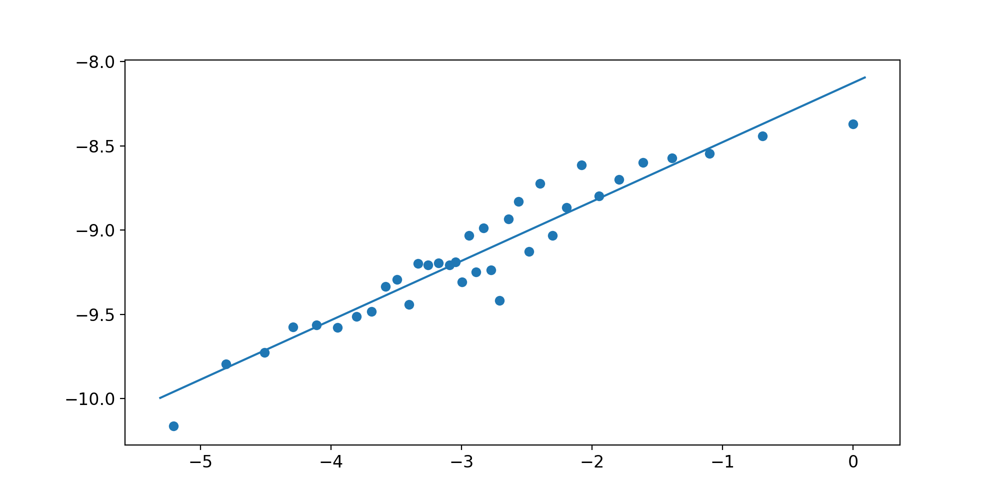

----------------------
---График для кластера: 218


<IPython.core.display.Javascript object>


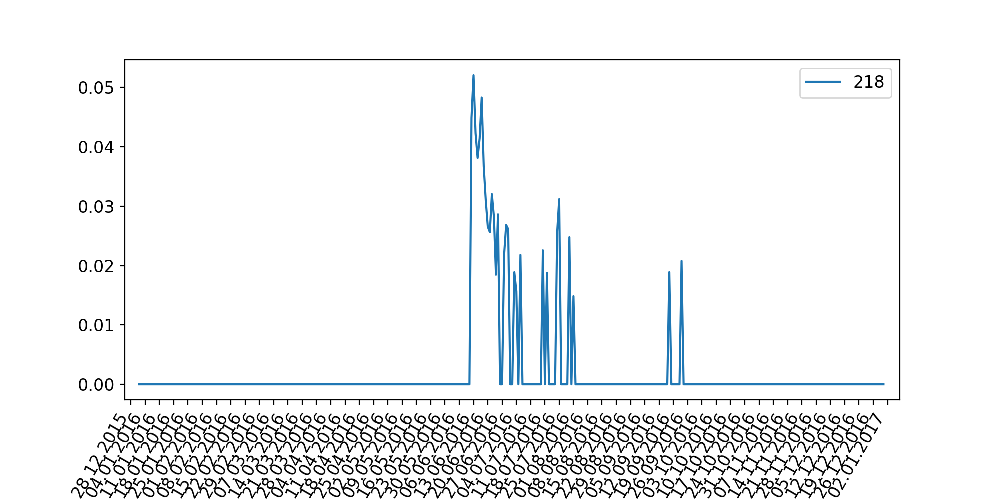

cluster: 218, 10 из 159 новостей:
	 В Орландо неизвестный открыл стрельбу и захватил заложников в ночном клубе
	 Во Флориде расстреляли посетителей ночного клуба
	 Стрелок из Орландо часто бывал в гей-клубе, в котором устроил стрельбу
	 Обама обвинил американских политиков в "оружейном" сговоре
	 Стрелок из Орландо требовал, чтобы США "прекратили бомбить его страну"
	 В США полиция не нашла связи между стрелком в Орландо и мужчиной со взрывчаткой
	 СМИ: Восемь жителей Орландо находятся в чёрном списке ИГИЛ
	 СМИ: стрелок из Орландо в Facebook предсказал новые атаки ИГ в США
	 Charlie Hebdo высмеяла теракт в Орландо
	 В США расследуют обстоятельства трагедии в Орландо
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 1.1338611047502265e-05, ln(variance): -11.387296749749847, ln(m): -5.209486152841421)
mi: 1/122, variance: 1.3877867289539212e-05, ln(variance): -11.185215268182933, ln(m): -4.804021044733257)
mi: 1/91, variance: 1.7333032378390477e-05, ln(variance): -10.9

<IPython.core.display.Javascript object>


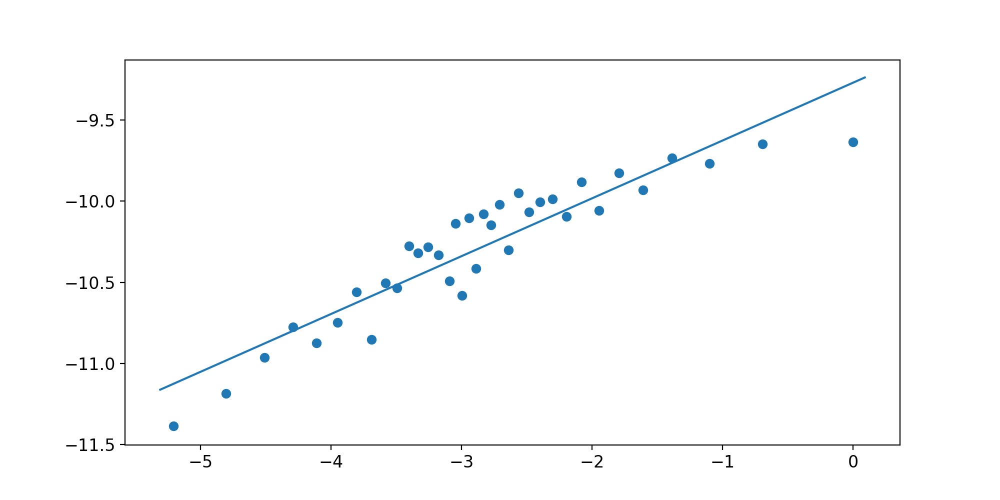

----------------------
---График для кластера: 27


<IPython.core.display.Javascript object>


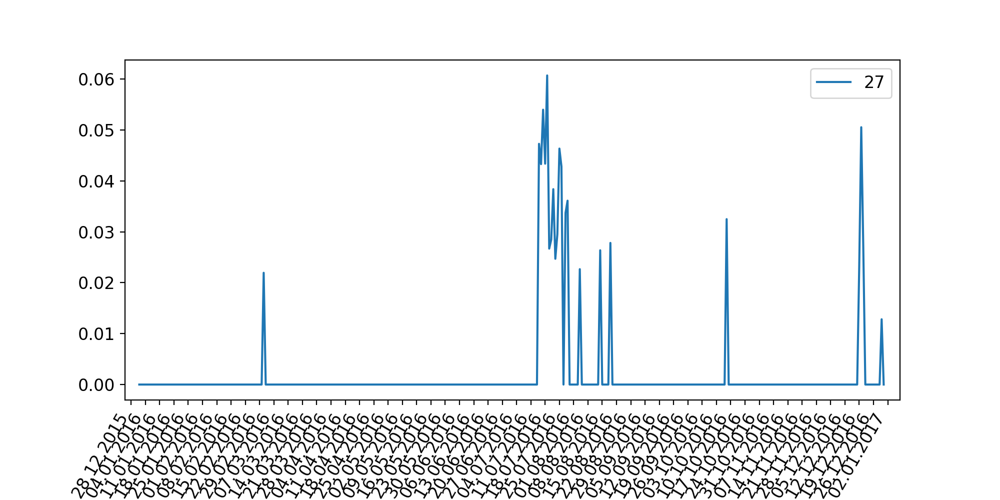

cluster: 27, 10 из 311 новостей:
	 СМИ: минимум 73 человека погибли, более 120 ранены после атаки в Ницце
	 Установлена личность погибшей во время теракта в Ницце россиянки
	 Террориста, убившего 84 человек в Ницце, звали Мохамед Лахуайедж Бухлель
	 После теракта в Ницце город переживает экономический спад
	 Полиция в Ницце обыскивает людей на улицах
	 Спецслужбы получили данные о подготовке терактов в РФ по сценарию атаки в Ницце
	 Опубликована фотография с жертвами ДТП в Ницце, где грузовик врезался в толпу
	 Эстрози: Во время теракта на набережной Ниццы было не больше 50 полицейских
	 Атака во время праздника: что известно о нападении в Ницце
	 Свидетельница теракта в Ницце: Во время давки каждый был сам за себя
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 1.1790513348838792e-05, ln(variance): -11.348215303324812, ln(m): -5.209486152841421)
mi: 1/122, variance: 2.1412882269429034e-05, ln(variance): -10.7515178418439, ln(m): -4.804021044733257)
mi: 1/91, varian

<IPython.core.display.Javascript object>


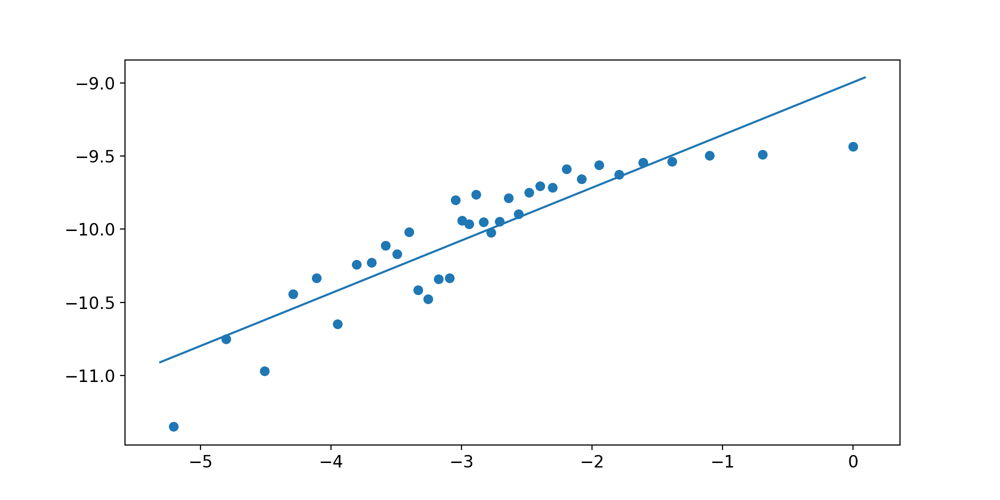

----------------------
---График для кластера: 3


<IPython.core.display.Javascript object>


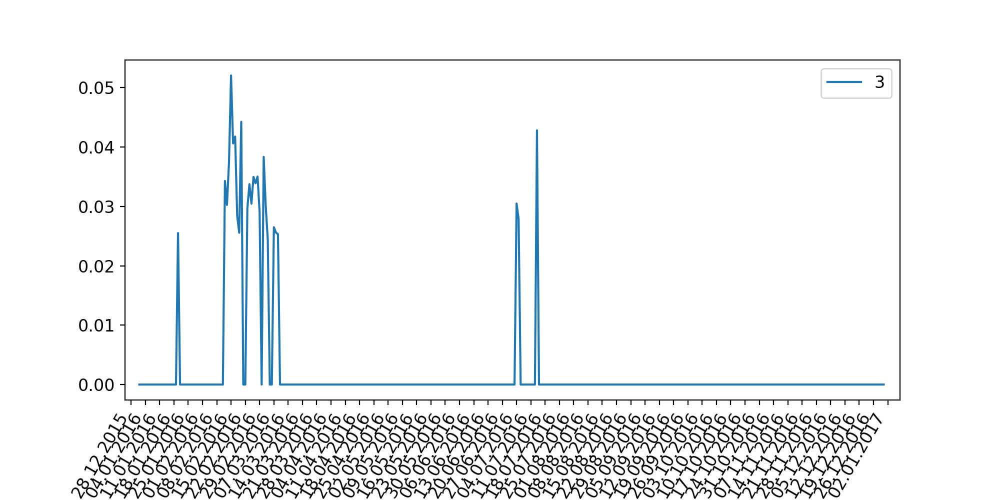

cluster: 3, 10 из 70 новостей:
	 Россия возобновила движение украинских грузовиков
	 Российские фуры блокируют почти на всем западе Украины
	 «Водители говорят, что это полная ж...»
	 Украинские фуры свободно ездят по России, российские на Украине - блокированы
	 Транзит всех украинских грузовиков по территории России полностью запрещен
	 Россия приостановила движение украинских фур
	 Медведев: остановившие фуры на границе - бандиты и сумасшедшие
	 Киев предупредил о планах не дать России «просто так» везти грузы в ЕС
	 Фура-патриоты
	 Направлявшиеся в Молдавию из России товары застряли на украинской границе
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 1.2919629901615219e-05, ln(variance): -11.256762705405924, ln(m): -5.209486152841421)
mi: 1/122, variance: 1.3481265077339666e-05, ln(variance): -11.21420960841627, ln(m): -4.804021044733257)
mi: 1/91, variance: 2.098499147073725e-05, ln(variance): -10.77170306762449, ln(m): -4.51085950651685)
mi: 1/73, variance: 2

<IPython.core.display.Javascript object>


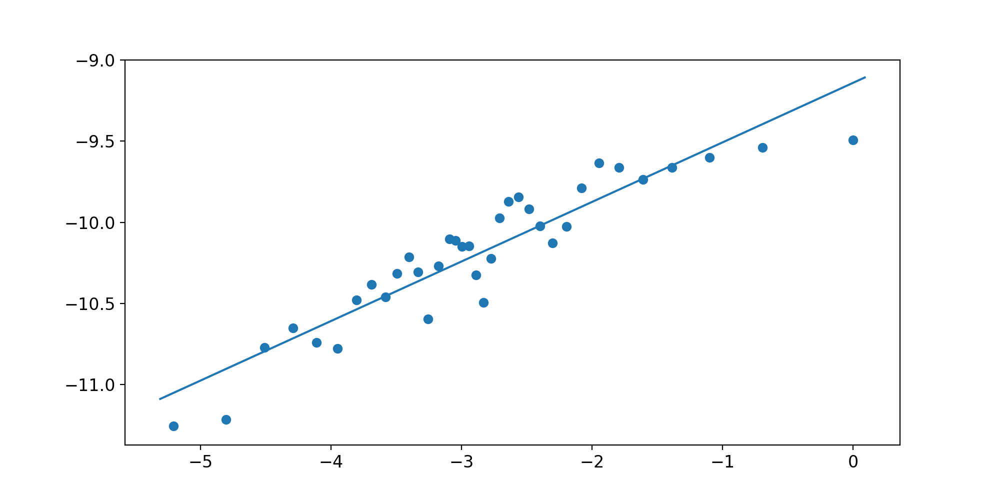

----------------------
---График для кластера: 108


<IPython.core.display.Javascript object>


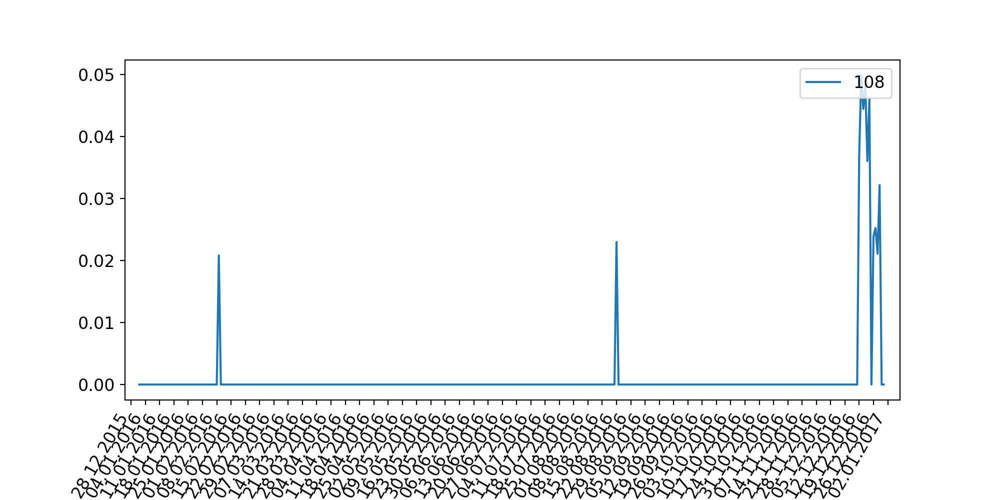

cluster: 108, 10 из 254 новостей:
	 Пользователи соцсетей назвали имя убийцы российского посла Андрея Карлова
	 Facebook объяснил удаление фото посла в Турции со страницы Захаровой
	 Российская следственная группа из 18 человек прибыла в Турцию для расследования убийства нашего посла
	 МИД Турции связал убийство посла России с проповедником Гюленом
	 Депутат Верховной рады Украины назвал "героем" убийцу посла России в Турции
	 СМИ назвали взявшую на себя ответственность за убийство посла организацию
	 Журналист, сравнивший русского посла с нацистским, отказался извиниться
	 На выставке "Россия глазами турок" в Анкаре ранили посла РФ
	 Убит посол России в Турции. Онлайн-трансляция
	 Андрею Карлову посмертно присвоили звание героя России
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 6.5189052233921444e-06, ln(variance): -11.94080410664694, ln(m): -5.209486152841421)
mi: 1/122, variance: 9.43445818244259e-06, ln(variance): -11.571141807136904, ln(m): -4.8040210447332

<IPython.core.display.Javascript object>


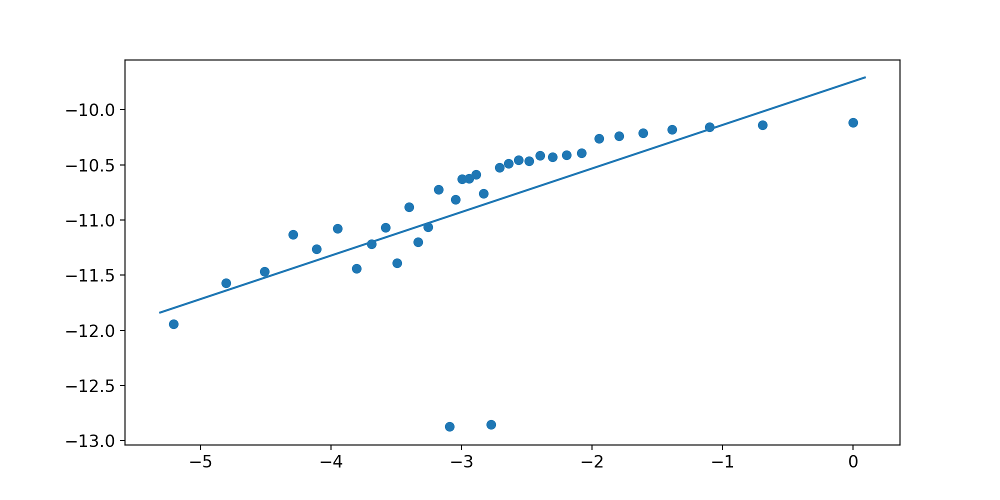

----------------------
---График для кластера: 159


<IPython.core.display.Javascript object>


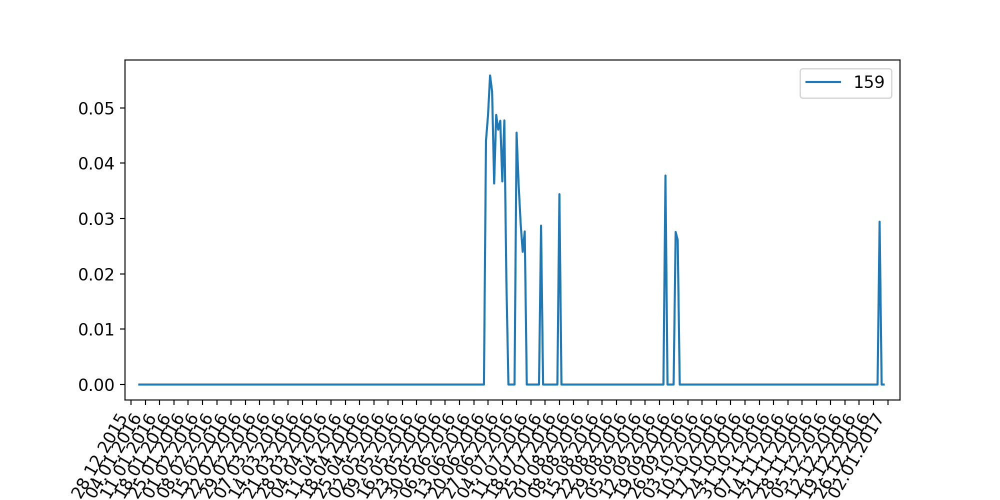

cluster: 159, 10 из 286 новостей:
	 Их едят, а они глядят
	 ЧП в лагере: акция по выявлению нарушений в детских оздоровительных учреждениях
	 В Карелии может быть закрыт лагерь, действовавший на берегу Сямозера
	 Установлено имя пропавшего без вести на озере в Карелии
	 Петиция в Сети: студенты-инструкторы лагеря на Сямозере сами пострадавшие
	 Путевки в лагерь на Сямозере продавали под девизом "Остаться в живых"
	 Задержан инструктор детского лагеря, где утонули 12 человек
	 Техника на грани абсурда. Почему спасатели не помогли детям, тонущим на Сямозере
	 Выплыл, но заблудился: МЧС не теряет надежды найти пропавшего на Сямозере ребенка
	 Власти Карелии подписали указ о выплате по 1 млн рублей семьям погибших детей
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 1.1660561619233905e-05, ln(variance): -11.3592982118868, ln(m): -5.209486152841421)
mi: 1/122, variance: 2.0527630128399473e-05, ln(variance): -10.793738768160592, ln(m): -4.804021044733257)
mi: 1/91, varia

<IPython.core.display.Javascript object>


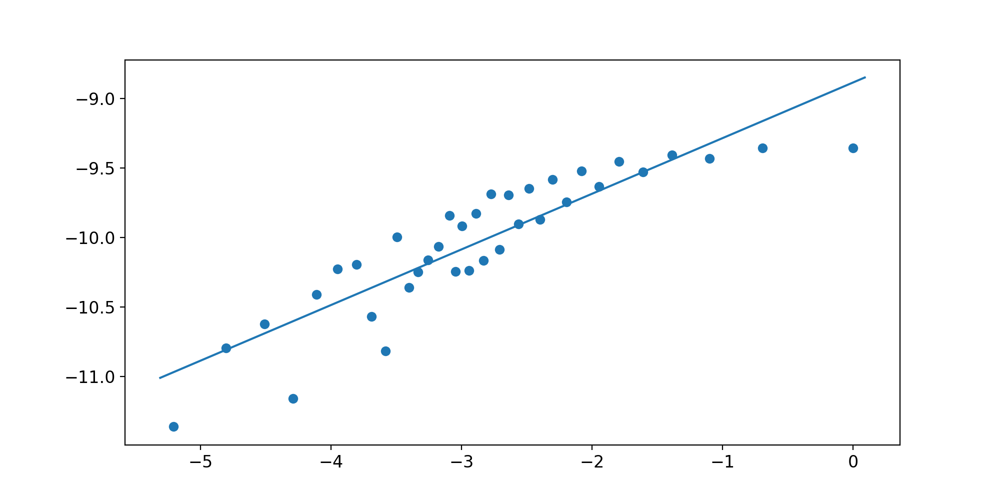

----------------------
---График для кластера: 122


<IPython.core.display.Javascript object>


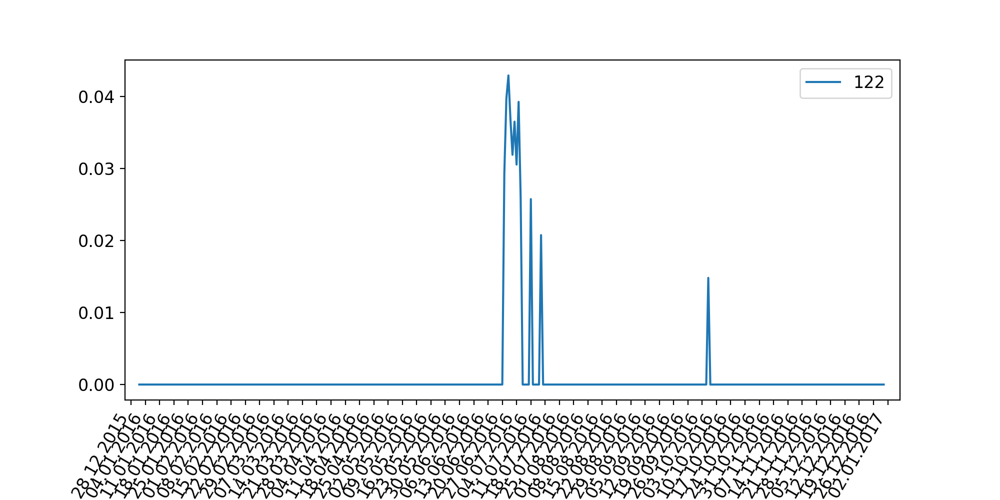

cluster: 122, 10 из 150 новостей:
	 Эрдоган подтвердил, что теракт в Стамбуле совершили выходцы из РФ и Средней Азии
	 Полиция подтвердила информацию о российском гражданстве террориста из Стамбула
	 Застрявшие в Турции дети из РФ отправятся домой после возобновления полетов
	 В Берлине Бранденбургские ворота подсветили в цвета флага Турции
	 Власти Стамбула: теракт в аэропорту унес жизни не менее 28 человек
	 Жертвами теракта в Стамбуле стали 28 человек
	 Эрдоган опроверг информацию о побеге боевиков после взрывов в аэропорту Стамбула
	 СМИ: за взрывами в Стамбуле может стоять ИГ
	 В аэропорту Стамбула прогремели два взрыва
	 ТВ: взрывы в Стамбуле осуществили двое смертников
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 3.305111074952876e-06, ln(variance): -12.620040477070184, ln(m): -5.209486152841421)
mi: 1/122, variance: 6.237295872952836e-06, ln(variance): -11.984963823201241, ln(m): -4.804021044733257)
mi: 1/91, variance: 4.951799619149627e-06, ln(variance):

<IPython.core.display.Javascript object>


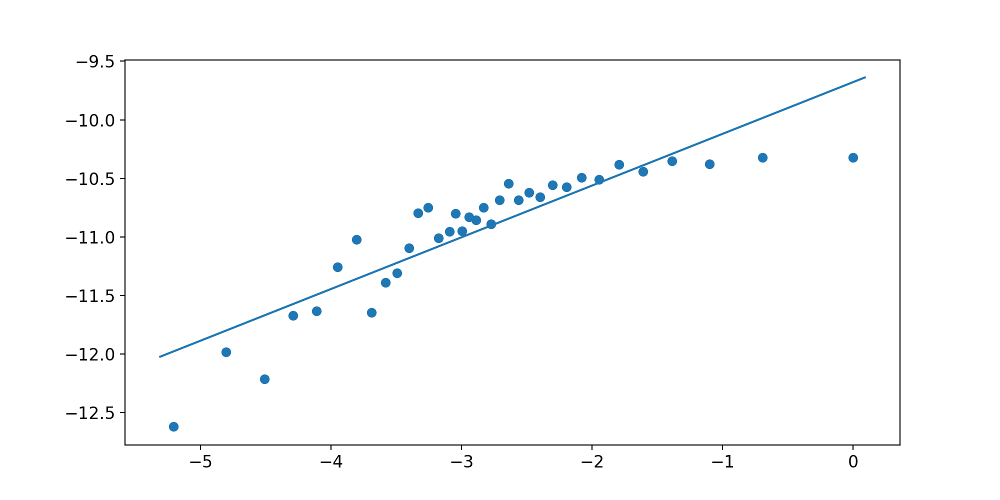

----------------------
---График для кластера: 32


<IPython.core.display.Javascript object>


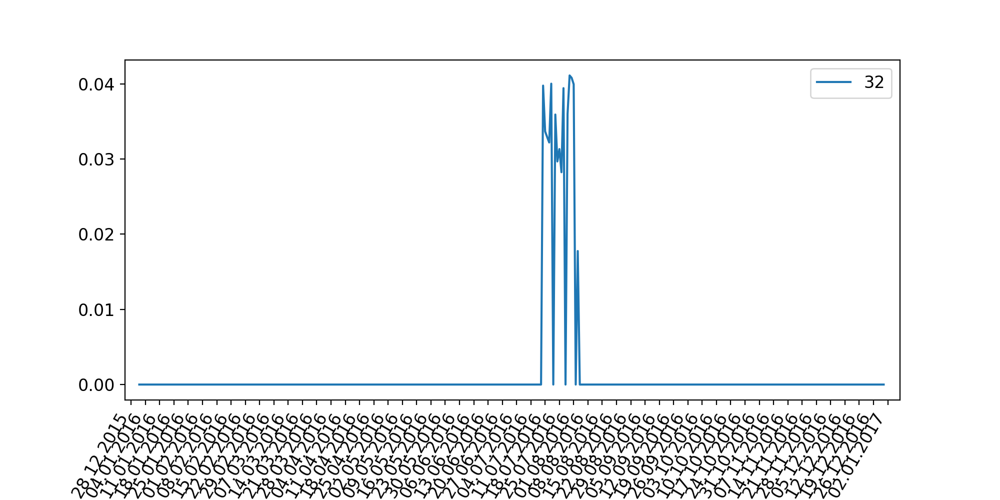

cluster: 32, 10 из 144 новостей:
	 В Ереване освободившие заложников оппозиционеры не намерены сдавать оружие
	 В результате беспорядков в Ереване несколько человек получили ранения
	 Лидер оппозиции в Армении прокомментировала захват заложников в Ереване
	 Полиция задержала десятки митингующих у захваченного здания ППС в Ереване
	 Ереванские демонстранты перекрыли автодвижение у захваченного отдела полиции
	 Опубликовано видео, как захватившие здание ППС в Ереване, сдаются властям
	 У захваченного в Ереване здания полиции раздались выстрелы
	 В Ереване ночью освободили одного из заложников, удерживаемых в здании полиции
	 Здание полиции в Ереване захватили, протаранив ворота отделения КрАЗом
	 Осада здания полиции в Ереване: радикалы отказались сложить оружие
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 4.899796085815215e-06, ln(variance): -12.226316968853379, ln(m): -5.209486152841421)
mi: 1/122, variance: 7.086623465966227e-06, ln(variance): -11.85730156979084

<IPython.core.display.Javascript object>


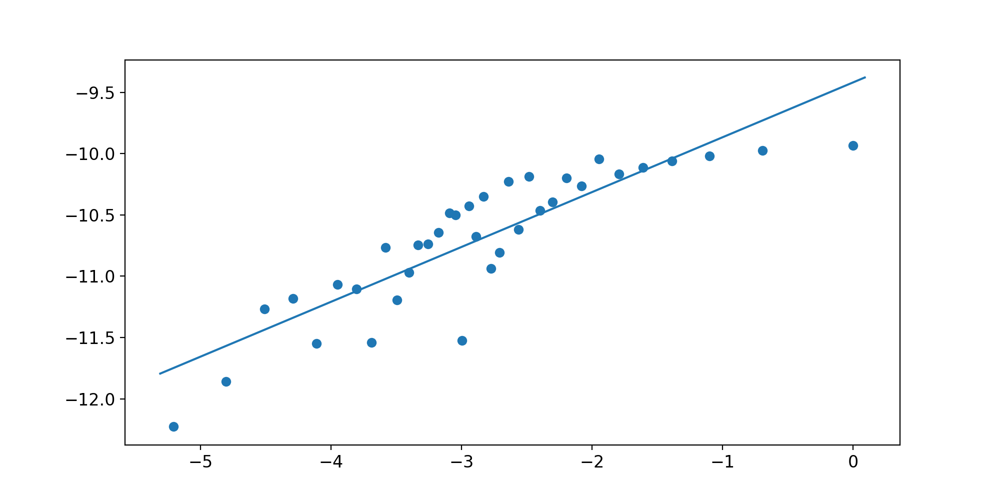

----------------------
---График для кластера: 96


<IPython.core.display.Javascript object>


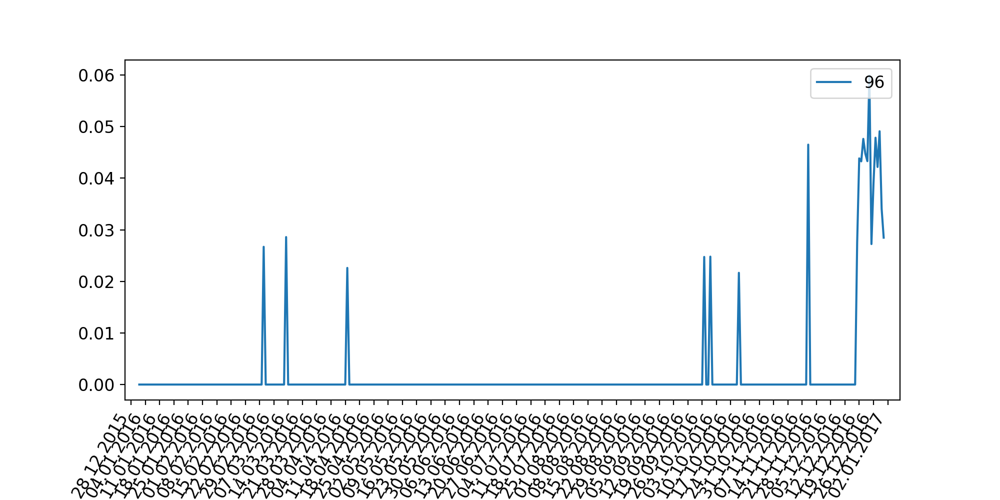

cluster: 96, 10 из 166 новостей:
	 В Иркутске арестован бизнесмен, которого обвиняют в массовой травле людей "Боярышником"
	 Единороссы хотят запретить продажу фанфуриков через автоматы
	 Число жертв отравления косметическим лосьоном в Иркутске достигло 26 человек
	 Восемь умерших в Иркутске пили настойку боярышника
	 Число погибших при отравлении "Боярышником" увеличилось до 21 человека
	 В больницах Иркутска от отравления "Боярышником" умерли ещё четыре человека
	 Хлопонин рассказал о валокордине по рецепту с апреля 2017 года
	 В Москве на месяц приостановлена торговля спиртосодержащей непищевой продукцией
	 Путин запретил продавать флакончики с алкоголем за "три копейки"
	 Продажу настойки боярышника ограничат с помощью ЕГАИС
---Результаты анализа самоподобия кластера
---
mi: 1/183, variance: 1.0123269973990059e-05, ln(variance): -11.500673826337474, ln(m): -5.209486152841421)
mi: 1/122, variance: 1.564432076081119e-05, ln(variance): -11.06540259752186, ln(m): -4.804021044733257)
mi

<IPython.core.display.Javascript object>


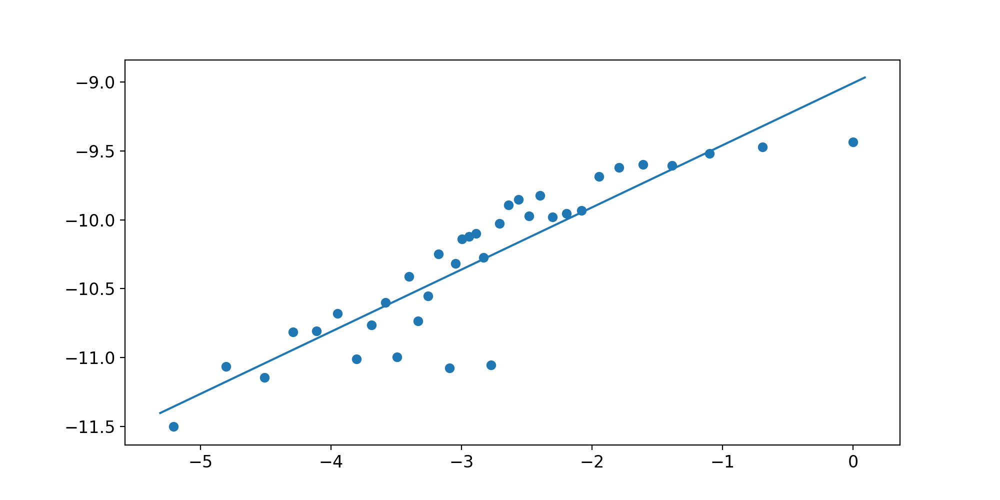

----------------------


In [75]:
for c_label, c_news, dd_cos, h_res in last_20:
    print("---График для кластера: %s" % (c_label))
    plot_cos_centroid(dd_cos, start_year, end_year, c_label)
    print_news(c_news, 10, c_label)
    hist = SelfSimilarityHirst()
    h_res = hist.compute(list(dd_cos.items()))
    print("---Результаты анализа самоподобия кластера")
    h_res.print_result()
    h_res.plot()
    print("----------------------")